In [10]:
# IMPORTING THE DATASET
from google.colab import drive
drive.mount('/content/drive')
!unzip -uq "/content/drive/My Drive/Colab Notebooks/TOP_DATA/training_data_10000.zip"  

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [12]:
def change_res(img,L):
  if L is "LOW":
    dim = (72,24)
  else:
    dim = (288,96)
  resized = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
  return resized

In [13]:
def load_image(i_mod,L,path):

      OUT = imageio.imread(path + "OUT/"+"OUT_"+ L+ i_mod + ".png", as_gray = True)
      BX = imageio.imread(path + "B/"+"BFX_"+ L+ i_mod + ".png", as_gray = True)
      BX  =  cv2.GaussianBlur(BX,gsize,cv2.BORDER_DEFAULT)
      BY  = imageio.imread(path + "B/"+"BFY_"+ L+ i_mod + ".png", as_gray = True)
      BY =  cv2.GaussianBlur(BY,gsize,cv2.BORDER_DEFAULT)
      FX  = imageio.imread(path + "F/"+"FX_"+ L+ i_mod + ".png", as_gray = True)
      #FX  =  cv2.GaussianBlur(FX,gsize,cv2.BORDER_DEFAULT)
      FY = imageio.imread(path + "F/"+"FY_"+ L+ i_mod + ".png", as_gray = True)
      #FY =  cv2.GaussianBlur(FY,gsize,cv2.BORDER_DEFAULT)        
      VF  = imageio.imread(path + "VF/"+"VF_"+ L + i_mod+".png")      
      OUT = change_res(OUT,L)
      BX = change_res(BX,L)
      BY = change_res(BY,L)
      FX = change_res(FX,L)
      FY = change_res(FY,L)
      VF = change_res(VF,L)
      IMG = np.stack([OUT,BX,BY,FX,FY,VF],2)


      return IMG

In [14]:
import numpy as np
import imageio
from tqdm import tqdm
import cv2

gsize  = (5,5)  
High_Res = []
Low_Res = []
ds = 6800
pt = 5
path = "data/"
L = "LOW"
H = "HIGH"

for i in tqdm(range(3601,ds+1)):
      i_mod = "{:01d}".format(i)  
      Low_Res.append(load_image(i_mod,L,path))
      High_Res.append(load_image(i_mod,H,path))


low_data = np.asarray(Low_Res)/127.5 - 1 
high_data = np.asarray(High_Res)/127.5 - 1

100%|██████████| 3200/3200 [00:22<00:00, 143.36it/s]


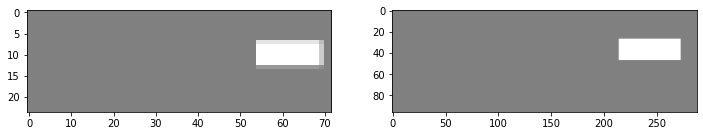

In [24]:
import matplotlib.pyplot as plt
K = 2030
ch = 5
plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(low_data[K,:,:,ch], cmap = 'gray', vmax = 1, vmin = -1)
plt.subplot(1,2,2)
plt.imshow(high_data[K,:,:,ch], cmap = 'gray', vmax = 1, vmin = -1)


In [25]:
def complex_to_real(data,ds):
  comp_time = np.zeros((ds,10), dtype = float)
  for i in range(ds):
    for j in range(5):
      a = data[j][i]  
      real, comp = a.split('+')
      comp = comp[:-1]
      real = float(real)
      comp = float(comp)
      comp_time[i,2*j] = real
      comp_time[i,2*j+1] = comp
  return comp_time


def find_faulty(data):
  low_faulty = data[:,6]
  high_faulty = data[:,8]  
  comp_faulty = data[:,3] 
  cmf = comp_faulty[np.nonzero(comp_faulty>0)]
  cmf = cmf[np.nonzero(cmf<5000)]
  ts = np.mean(cmf) + 2*np.std(cmf)
  print(ts)
  K1 = np.nonzero(low_faulty>0)
  K2 = np.nonzero(high_faulty>0)
  K3 = np.nonzero(comp_faulty>ts)
  K = np.union1d(K1,K2)
  K = np.union1d(K,K3)
  return K       



In [26]:
import pandas as pd

CT1= pd.read_csv("/content/drive/My Drive/Colab Notebooks/TOP_DATA/comp_time_3601_5000_.csv", header= None)
CT2= pd.read_csv("/content/drive/My Drive/Colab Notebooks/TOP_DATA/comp_time_5001_6800_.csv", header= None)
comp_time1 = complex_to_real(CT1,5000)[3600:5000,:]
comp_time2 = complex_to_real(CT2,6800)[5000:6800,:]

print(comp_time1.shape)
comp_time = np.vstack((comp_time1,comp_time2))
print(comp_time.shape)
print(comp_time)

(1400, 10)
(3200, 10)
[[3.60100000e+03 1.10005480e+02 5.82300201e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.60200000e+03 1.18101707e+02 9.97188315e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.60300000e+03 2.29947995e+01 5.07551059e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [6.79800000e+03 6.17615100e+00 2.49898061e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.79900000e+03 2.11326552e+02 6.18795678e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.80000000e+03 1.84033478e+01 3.53417918e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [27]:
faulty_cases = find_faulty(comp_time)
comp_time = np.delete(comp_time,faulty_cases,axis=0)
low_data = np.delete(low_data,faulty_cases,0)
high_data = np.delete(high_data,faulty_cases,0)

431.62234914244


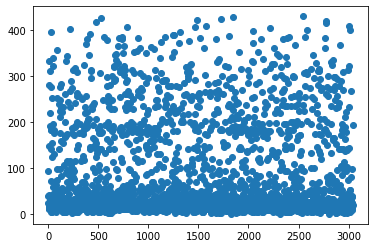

In [28]:
plt.scatter(np.linspace(0,comp_time.shape[0]-1,comp_time.shape[0]),comp_time[:,3])

In [29]:
print(low_data.shape)
print(high_data.shape)
print(comp_time.shape)

(3042, 24, 72, 6)
(3042, 96, 288, 6)
(3042, 10)


# HELPER FUNCTIONS


In [35]:
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
low_pb = (24,72,5)
low_sol = (24,72,1)
high_pb = (96,288,5)
high_sol = (96,288,1)

In [36]:
def downsample(filters, size, std = 2, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)
  

  result = tf.keras.Sequential()
  result.add(layers.Conv2D(filters, size, strides=std, padding='same',
                             kernel_initializer=initializer, use_bias=False))
 
  if apply_batchnorm:
    result.add(layers.BatchNormalization())

  result.add(layers.LeakyReLU())

  return result

In [37]:
def upsample(filters, size,std = 2,apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)


  result = tf.keras.Sequential()
  result.add(layers.Conv2DTranspose(filters, size, strides=std,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))
  result.add(layers.BatchNormalization())

  if apply_dropout:
      result.add(layers.Dropout(0.2))

  result.add(layers.ReLU())
  
  return result

In [43]:
def Comp_network(sol = high_sol,pb = high_pb):
    initializer = tf.random_normal_initializer(0., 0.02)
    inpimg = layers.Input(shape = pb)
    tar = layers.Input(shape = sol)

    y = inpimg
    y = downsample(64,3)(y)
    y = downsample(128,3)(y)
    y = downsample(256,3)(y)
    y = downsample(512,3)(y)
    y = downsample(1024,3)(y)
    y = layers.Flatten()(y)    
    y = layers.Dense(16,activation = 'relu',kernel_initializer=initializer)(y) 


    x = tar
    x1 = downsample(32,2)(x)
    x2 = downsample(32,4)(x)
  
    x1 = downsample(64,2)(x1)
    x2 = downsample(64,4)(x2)

    x1 = downsample(128,2)(x1)
    x2 = downsample(128,4)(x2)
  
    x1 = downsample(256,2)(x1)
    x2 = downsample(256,4)(x2)
    
    x1 = downsample(512,2)(x1)
    x2 = downsample(512,4)(x2)

    x = layers.Concatenate()([x1,x2])                            
    x = layers.Flatten()(x)
    
    x = layers.Dense(16,activation = 'relu',kernel_initializer=initializer)(x)


    x = layers.Multiply()([x,y])  

    # x = layers.Conv2D(64,3, padding = 'same', activation= 'relu', kernel_initializer=initializer)(x)#64
    # x = layers.AveragePooling2D()(x)#32
    # x = layers.Conv2D(128,4, padding = 'same', activation= 'relu', kernel_initializer=initializer)(x)#16
    # x = layers.MaxPooling2D()(x)#16
    # x = layers.Conv2D(256,4, padding = 'same', activation= 'relu', kernel_initializer=initializer)(x) 
    # x = layers.AveragePooling2D()(x)#8
    # x = layers.Conv2D(512,5, padding = 'same', activation= 'relu', kernel_initializer=initializer)(x)
    # x = layers.MaxPooling2D()(x)#4
    # x = layers.Conv2D(1024,4, padding = 'same', activation= 'relu', kernel_initializer=initializer)(x)
    # x = layers.AveragePooling2D()(x)#4
    # x = layers.Flatten()(x)
    
    x = layers.Dense(4,activation = 'relu',kernel_initializer=initializer)(x)
    x = layers.Dense(1,activation = 'linear',kernel_initializer=initializer)(x)

    return tf.keras.Model(inputs = [tar,inpimg], outputs=x)


Model: "functional_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 96, 288, 1)] 0                                            
__________________________________________________________________________________________________
sequential_38 (Sequential)      (None, 48, 144, 32)  256         input_8[0][0]                    
__________________________________________________________________________________________________
sequential_39 (Sequential)      (None, 48, 144, 32)  640         input_8[0][0]                    
__________________________________________________________________________________________________
input_7 (InputLayer)            [(None, 96, 288, 5)] 0                                            
_______________________________________________________________________________________

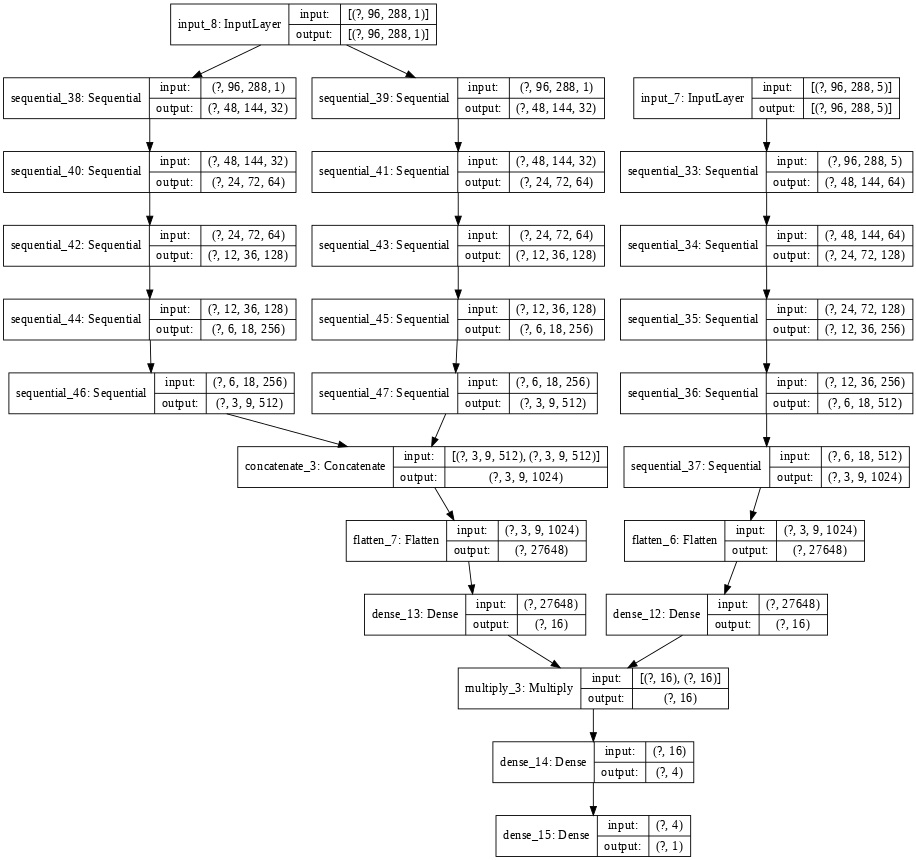

In [44]:
CompNET = Comp_network()
CompNET.summary()

tf.keras.utils.plot_model(CompNET, show_shapes=True, dpi=64)

In [49]:
@tf.function
def fn():
  with tf.init_scope():
    print(tf.executing_eagerly())
  #print(tf.executing_eagerly())
fn()

True


In [50]:
# def mse_maxloss(y_true,y_pred,alpha = 0.5):
#   mse_loss = lsq(y_true,y_pred)
#   worst_loss = lsq(y_true,y_pred)
#   loss = mse_loss + alpha*worst_loss
#   return loss

def norm_trans(data):
  maxcomp = np.max(data)
  mincomp = np.min(data)
  C = data - mincomp
  D = maxcomp - mincomp
  return C/D,maxcomp,mincomp

def back_norm(data,maxcomp,mincomp):
  C = data + mincomp
  D = maxcomp - mincomp
  return D*C


In [47]:
CompNET.compile(optimizer='adam',loss= 'mse', metrics='mae')

In [51]:
x = high_data[:,:,:,1:6]
y = high_data[:,:,:,0:1]  
tar,maxcomp,mincomp = norm_trans(comp_time[:,3])
#tar = comp_time[:,3]
print(np.mean(tar),np.median(tar))

filepath = '/content/drive/My Drive/Colab Notebooks/CompNET/'
checkpointer =  tf.keras.callbacks.ModelCheckpoint('compnet2.h5', verbose=1, monitor='val_loss',save_best_only=True)


0.17288287018998513 0.05916709134281149


In [52]:
history = CompNET.fit(x=[y,x],y = tar,epochs = 100,verbose = 1,batch_size= 100, validation_split=0.3,callbacks=[checkpointer])
#val mse 0.01187,0.013, 2227

Epoch 1/100
22/22 [==============================] - ETA: 0s - loss: 0.1788 - mae: 0.1951
Epoch 00001: val_loss improved from inf to 0.07561, saving model to compnet2.h5
22/22 [==============================] - 8s 381ms/step - loss: 0.1788 - mae: 0.1951 - val_loss: 0.0756 - val_mae: 0.1634
Epoch 2/100
22/22 [==============================] - ETA: 0s - loss: 0.0242 - mae: 0.0982
Epoch 00002: val_loss improved from 0.07561 to 0.06947, saving model to compnet2.h5
22/22 [==============================] - 7s 308ms/step - loss: 0.0242 - mae: 0.0982 - val_loss: 0.0695 - val_mae: 0.1470
Epoch 3/100
22/22 [==============================] - ETA: 0s - loss: 0.0142 - mae: 0.0794
Epoch 00003: val_loss improved from 0.06947 to 0.06517, saving model to compnet2.h5
22/22 [==============================] - 7s 311ms/step - loss: 0.0142 - mae: 0.0794 - val_loss: 0.0652 - val_mae: 0.1386
Epoch 4/100
22/22 [==============================] - ETA: 0s - loss: 0.0115 - mae: 0.0662
Epoch 00004: val_loss did not

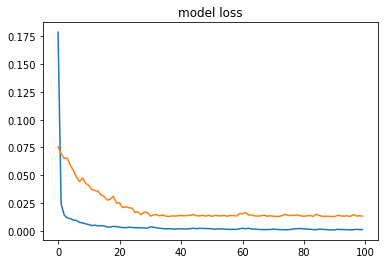

In [57]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
CompNET.load_weights('compnet2.h5')
CompNET.save('/content/drive/My Drive/Colab Notebooks/CompNET/compnet2.h5')
#CompNET.load_weights('/content/drive/My Drive/Colab Notebooks/CompNET/compnet.h5')

In [58]:
x1 = high_data[0:200,:,:,1:6]
y1 = high_data[0:200,:,:,0:1]
z1 = back_norm(CompNET([y1,x1],training=False),maxcomp,mincomp)
#z1 = CompNET([y1,x1],training=False)
tar1 = comp_time[0:200,3]

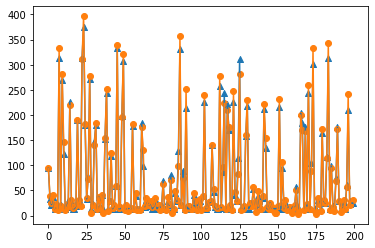

In [59]:
plt.scatter(np.linspace(0,199,200),z1,marker='^')
plt.plot(z1)
plt.scatter(np.linspace(0,199,200),comp_time[0:200,3],marker='o')
plt.plot(comp_time[0:200,3])

In [60]:
x = low_data[3:4,:,:,:]
x = downsample(10,3,2)(x)
print(x.shape)
x = downsample(20,3,3)(x)
print(x.shape)
x = upsample(20,3,3)(x)
print(x.shape)

(1, 12, 36, 10)
(1, 4, 12, 20)
(1, 12, 36, 20)


# L-GAN

In [ ]:
def LGen(pb = low_pb):

  initializer = tf.random_normal_initializer(0., 0.02)
  inpimg = layers.Input(shape = pb)#24,72
  x = downsample(6,4)(inpimg)#12,36
  x1 = downsample(64,4)(x0) #6,18
  x2 = downsample(128,4)(x1) #3,9
  x = downsample(256,4)(x2)#3,8
  x = layers.Flatten()(x)
  x = layers.Dense(8,activation='relu',kernel_initializer=initializer)(x)
  x = layers.Dense(3*8*256,activation='relu',kernel_initializer=initializer)(x)
  x = layers.Reshape((3,8,256))(x)  
  x = upsample(256,4)(x)#6,16
  x = layers.Concatenate()([x,x2])  
  x = upsample(128,4)(x)#12,32
  x = layers.Concatenate()([x,x1])  
  x = upsample(64,4)(x)
  x = layers.Concatenate()([x,x0])
  x = layers.Conv2D(32,5,activation = 'tanh', kernel_initializer=initializer)(x)
  x = layers.Concatenate()([x,inpimg])
  x = layers.Conv2D(1,3, activation = 'tanh',padding = 'same',kernel_initializer=initializer)(x)

  return tf.keras.Model(inputs=[inpimg], outputs=x)

In [ ]:
def LDisc(sol = low_sol,pb = low_pb):
  
  initializer = tf.random_normal_initializer(0., 0.02)
  inpimg = layers.Input(shape = pb)
  sol = layers.Input(shape = sol)
  x = layers.Concatenate()([inpimg,sol])
  x = downsample(64,4)(x)
  x = downsample(128,4)(x)
  x = downsample(256,4)(x)
  x = layers.Flatten()(x)
  x = layers.Dense(1,activation = 'sigmoid',kernel_initializer = initializer)(x)

  return tf.keras.Model(inputs=[sol,inpimg], outputs=x)


Model: "functional_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 20, 60, 5)]  0                                            
__________________________________________________________________________________________________
sequential_15 (Sequential)      (None, 20, 60, 32)   2688        input_3[0][0]                    
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 24, 64, 32)   0           sequential_15[0][0]              
__________________________________________________________________________________________________
sequential_16 (Sequential)      (None, 12, 32, 64)   33024       zero_padding2d[0][0]             
_______________________________________________________________________________________

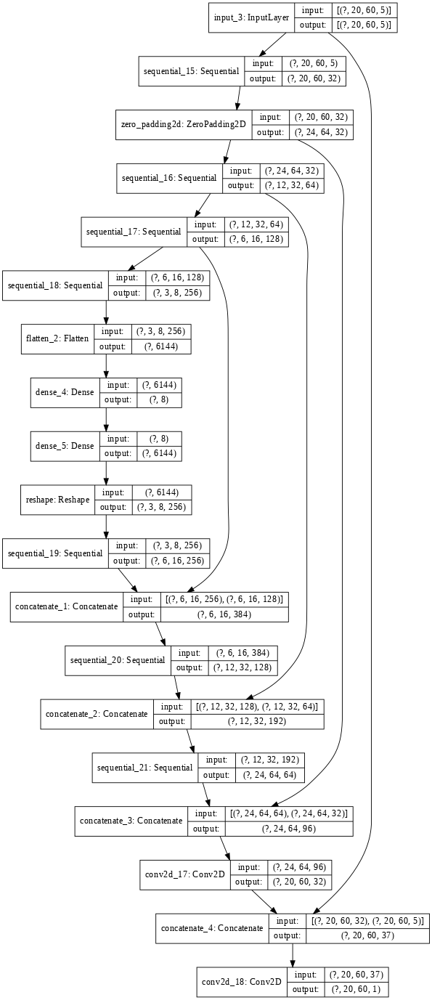

In [ ]:
# TESTING
lgen = LGen()
ldisc = LDisc()
lgen.summary()
tf.keras.utils.plot_model(lgen, show_shapes=True, dpi=64)

In [ ]:
ldisc.summary()

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 20, 60, 5)]  0                                            
__________________________________________________________________________________________________
input_5 (InputLayer)            [(None, 20, 60, 1)]  0                                            
__________________________________________________________________________________________________
concatenate_5 (Concatenate)     (None, 20, 60, 6)    0           input_4[0][0]                    
                                                                 input_5[0][0]                    
__________________________________________________________________________________________________
sequential_22 (Sequential)      (None, 10, 30, 64)   6400        concatenate_5[0][0]   

# H-GAN

In [ ]:
def upinc_block(x,filters)-> tf.Tensor:

    initializer = tf.random_normal_initializer(0., 0.02)
    
    x1 = upsample(filters,3)(x) # UPSAMPLED

    x2 = upsample(filters,3,1)(x) 
    x2 = upsample(filters,5)(x2) #U

    x3 = upsample(filters,3,1)(x) 
    x3 = upsample(filters,7)(x3) #U 

    x4 = layers.UpSampling2D(2)(x)
    x4 = upsample(filters,3,1)(x4)

    out = layers.Concatenate()([x1,x2,x3,x4])
    out = layers.ReLU()(out)
    out = layers.BatchNormalization()(out)
    
    return out

In [ ]:
def downinc_block(x,filters)-> tf.Tensor:

    initializer = tf.random_normal_initializer(0., 0.02)
    
    x1 = downsample(filters,1)(x) # DownSAMPLED

    x2 = downsample(filters,3,1)(x) 
    x2 = downsample(filters,5)(x2) #D

    x3 = downsample(filters,3,1)(x) 
    x3 = downsample(filters,7)(x3) #D 

    x4 = layers.MaxPooling2D(2)(x)#D
    x4 = downsample(filters,3,1)(x4)

    out = layers.Concatenate()([x1,x2,x3,x4])
    out = layers.LeakyReLU()(out)
    out = layers.BatchNormalization()(out)
    
    return out

In [ ]:
def residual_block(t,filters,kernel_size = 3,std = 2)-> tf.Tensor:

    initializer = tf.random_normal_initializer(0., 0.02)


    y = layers.BatchNormalization()(t)
    y = layers.LeakyReLU()(y)

    y = layers.Conv2D(kernel_size=kernel_size,
               strides= std,filters=filters,kernel_initializer=initializer,
               padding="same")(t)

    y = layers.BatchNormalization()(y)
    y = layers.LeakyReLU()(y)   


    y = layers.Conv2D(kernel_size=kernel_size,
               strides=1,filters=filters,kernel_initializer=initializer,
               padding="same")(y)

    if std > 1:
       x = layers.Conv2D(kernel_size=1,
                   strides=std,filters=filters,kernel_initializer=initializer,
                   padding="same")(t)       
    else:
       x = t       
      
    out = layers.Add()([x, y])
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)    
    return out

In [ ]:
def HGen(pb = high_pb, sol = low_sol): 
  
  initializer = tf.random_normal_initializer(0., 0.02)

  inpimg = layers.Input(shape = pb)#100,300
  lowsol = layers.Input(shape = sol)#20,60

  x = lowsol
  y = inpimg
  
  z = layers.UpSampling2D(5)(x)
  x = layers.ZeroPadding2D((2,2))(x)#24,64
  x = downinc_block(x,2)#12,32
  x = downinc_block(x,4)#6,16
  x = downinc_block(x,8)#3,32
  x = layers.Flatten()(x)
  x = layers.Dense(32,activation='relu',kernel_initializer=initializer)(x)

  y = downsample(16,3)(y)
  y = downsample(32,4)(y)
  y = downsample(64,4)(y)
  y = downsample(128,5)(y)
  y = layers.Flatten()(y)    
  y = layers.Dense(32,activation = 'relu',kernel_initializer=initializer)(y) 

  x = layers.Multiply()([x,y])
  x = layers.Dense(25*75*8,activation='relu',kernel_initializer=initializer)(x)
  x = layers.Reshape((25,75,8))(x)

  x = layers.Conv2D(64,3,activation = 'tanh',padding='same',kernel_initializer=initializer)(x)

  x = residual_block(x,64,3,1)
  x = residual_block(x,64,3,1)
  x = residual_block(x,64,3,1)
  x = residual_block(x,64,3,1)

  x = upinc_block(x,8)  
  x = upinc_block(x,4)
  x = layers.Concatenate()([x,z])
  x = layers.Conv2D(1,3,padding='same',activation='tanh',kernel_initializer=initializer)(x)  

  return tf.keras.Model(inputs = [inpimg,lowsol], outputs=x)

In [ ]:
hgen = HGen()
hgen.summary()
#tf.keras.utils.plot_model(hgen, show_shapes=True, dpi=64)

Model: "functional_35"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_55 (InputLayer)           [(None, 20, 60, 1)]  0                                            
__________________________________________________________________________________________________
zero_padding2d_23 (ZeroPadding2 (None, 24, 64, 1)    0           input_55[0][0]                   
__________________________________________________________________________________________________
sequential_698 (Sequential)     (None, 24, 64, 2)    26          zero_padding2d_23[0][0]          
__________________________________________________________________________________________________
sequential_700 (Sequential)     (None, 24, 64, 2)    26          zero_padding2d_23[0][0]          
______________________________________________________________________________________

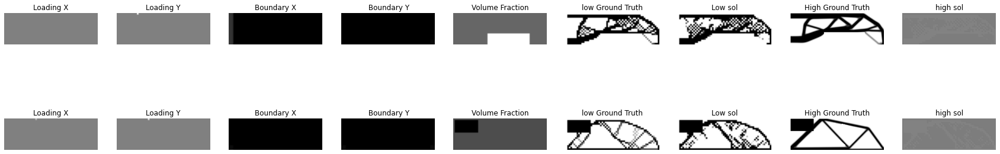

In [ ]:
fig = plt.figure(figsize=(30,6))
K = [23,343]
pred = generate_images(K,len(K),lgen,hgen,ldisc,CompNET, mode = 2)

# GENERATING IMAGES

In [ ]:
def generate_images(arr,number_of_samples,lgen,hgen,ldisc,CompNET,mode = 1):

  lowsol = low_data[arr,:,:,0:1]
  lowpb = low_data[arr,:,:,1:6]

  highsol = high_data[arr,:,:,0:1]
  highpb = high_data[arr,:,:,1:6]
  test_input = low_data[arr,:,:,:]


  low_pred = lgen(lowpb, training = False)
  if mode == 2:
     high_pred = hgen([highpb,low_pred], training = False)
  else:
     high_pred = low_pred


  idx = 1
  #plt.figure(figsize=(20,20))
  title = ['Loading X', 'Loading Y', 'Boundary X',' Boundary Y', 'Volume Fraction','low Ground Truth', 'Low sol','High Ground Truth','high sol']
  for j in range(number_of_samples):
    
    display_list = [test_input[j,:,:,3], test_input[j,:,:,4], -test_input[j,:,:,1], -test_input[j,:,:,2], test_input[j,:,:,5], lowsol[j,:,:,0], low_pred[j,:,:,0],highsol[j,:,:,0],high_pred[j,:,:,0]]

    for i in range(9):
      
      plt.subplot(number_of_samples, 9, idx)
      plt.title(title[i])
      idx = idx + 1
      # getting the pixel values between [0, 1] to plot it.
      if i is 4:
        plt.imshow(display_list[i]*127.5 + 127.5, cmap = 'gray',vmin = 0 , vmax = 255)
      else:
        plt.imshow(display_list[i]*127.5 + 127.5, cmap = 'gray',vmin = 0 , vmax = 255)
      plt.axis('off')


In [ ]:
def generate_and_save_images(epoch,K,lgen,hgen,ldisc,CompNET,mode = 2):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm). 
  fig = plt.figure(figsize=(20,3*len(K)/2))
  pred = generate_images(K,len(K),lgen,hgen,ldisc,CompNET,mode)
  plt.savefig("/content/drive/My Drive/Colab Notebooks/LGAN/"+"image_at_epoch_{:04d}.png".format(epoch))
  plt.show()

# Training LGAN

In [ ]:
lgen_optimizer = tf.keras.optimizers.Adam(lr = 2e-4, beta_1 = 0.5, beta_2 = 0.999)
ldisc_optimizer = tf.keras.optimizers.RMSprop(lr = 2e-4)


import os
checkpoint_dir = '/content/drive/My Drive/Colab Notebooks/LGAN'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
# checkpoint = tf.train.Checkpoint(lgen_optimizer = lgen_optimizer,
#                                  hgen_optimizer = hgen_optimizer, ldisc_optimizer = ldisc_optimizer,
#                                  lgen = lgen, hgen = hgen, ldisc= ldisc, CompNET = CompNET)
checkpoint = tf.train.Checkpoint(lgen_optimizer = lgen_optimizer,
                                  ldisc_optimizer = ldisc_optimizer,
                                  lgen = lgen,ldisc= ldisc)
test = [21,343]
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)



In [ ]:
mae = tf.keras.losses.MeanAbsoluteError()
lsq = tf.keras.losses.MeanSquaredError()
def train_step(low_img):

    with tf.GradientTape() as lgen_tape, tf.GradientTape() as ldisc_tape:
      
      # IMAGES
      lowsol = low_img[:,:,:,0:1]
      lowpb = low_img[:,:,:,1:6]
      

      #highsol = high_img[:,:,:,0:1]
      #highpb = high_img[:,:,:,1:6]

      # PREDICTION - Generators
      low_pred = lgen(lowpb, training = True)
      #high_pred = hgen([highpb,low_pred], training = True)

      # LOW DISCRIMINTAOR
      real_output = ldisc([lowsol,lowpb],training=True)
      fake_output = ldisc([low_pred,lowpb], training=True) 

      # CALCULATING LOSSES
      real_loss =  lsq(tf.ones_like(real_output),real_output)
      fake_loss =  lsq(tf.zeros_like(fake_output),fake_output)
      adv_loss =   lsq(tf.ones_like(fake_output),fake_output)

      # L2 LOSS
      low_L1 = mae(lowsol,low_pred)

      #high_L1 = mse_maxloss(highsol,high_pred,0)

       # Compliance loss
      #comp_real = CompNET([highsol,highpb],training = False)
      #comp_fake = CompNET([high_pred,highpb], training = False)
 

      # lDISC LOSS
      ldisc_loss = fake_loss + real_loss
      # lGEN LOSS      
      lgen_loss = adv_loss + 20*low_L1 #pix2pix
      # hgen loss
      #hgen_loss = tf.reduce_mean(tf.abs(comp_real-comp_fake)) + 20*high_L1

      #loss_temp = [real_loss,fake_loss,adv_loss,low_L1,high_L1, tf.reduce_mean(tf.abs(comp_real-comp_fake))]
      loss_temp = [real_loss,fake_loss,adv_loss,low_L1]
      
 
    gradients_of_lgen = lgen_tape.gradient(lgen_loss, lgen.trainable_variables)
    gradients_of_ldisc = ldisc_tape.gradient(ldisc_loss, ldisc.trainable_variables)
    #gradients_of_hgen = hgen_tape.gradient(hgen_loss, hgen.trainable_variables)
    
    lgen_optimizer.apply_gradients(zip(gradients_of_lgen, lgen.trainable_variables))
   
    ldisc_optimizer.apply_gradients(zip(gradients_of_ldisc, ldisc.trainable_variables))

    #hgen_optimizer.apply_gradients(zip(gradients_of_hgen, hgen.trainable_variables))
    return loss_temp
    

In [ ]:
import time
def train(low_dataset,epochs):
  Loss_mat = []  


  #BATCH_SIZE = numpy.around(train_data.shape[0]/No_of_batch, decimals = 0)

  for epoch in range(epochs):
    start = time.time()
    # Loss_TRAIN = []
    #Loss_TEST = []
    

    for low_img in low_dataset:
      
      loss_train = train_step(low_img)

 
    # DETERMINING AVG LOSS
    Loss_mat.append(loss_train)
    loss_epoch = np.asarray(loss_train)

    # SAVE THE BEST MODEL ONLY
    #loss_epoch = numpy.array(loss_epoch)
    if (epoch + 1) % 20 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)
      print('MODEL SAVED')

    # else:
    #   checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
    #display.clear_output(wait=True)
    generate_and_save_images(epoch+1,test,lgen,hgen,ldisc,CompNET)
    #print ('Time for epoch {} is {} sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1,high_L1, comp_loss]: [{:.4},{:.4},{:.4},{:.4},{:.4},{:.4}]) '.format(epoch + 1,time.time()-start,
     #                                                                        loss_epoch[0],loss_epoch[1], loss_epoch[2], loss_epoch[3], loss_epoch[4], loss_epoch[5]))
    print ('Time for epoch {} is {} sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [{:.4},{:.4},{:.4},{:.4}]) '.format(epoch + 1,time.time()-start,
                                                                            loss_epoch[0],loss_epoch[1], loss_epoch[2], loss_epoch[3]))
    #print ('Time for epoch {} is {} sec: Training LOSS [disc loss,adv_loss,low_L1,total_gen]: [{:.4},{:.4},{:.4},{:.4}]) '.format(epoch + 1,time.time()-start,
    #                                                                        loss_epoch[0],loss_epoch[1], loss_epoch[2], loss_epoch[3]))


  # Generate after the final epoch
  #display.clear_output(wait=True)
  generate_and_save_images(epochs,test,lgen,hgen,ldisc,CompNET)
  return Loss_mat

In [ ]:
BATCH_SIZE = 50
low_dataset = tf.data.Dataset.from_tensor_slices(np.asarray(low_data)).batch(BATCH_SIZE)
high_dataset = tf.data.Dataset.from_tensor_slices(np.asarray(high_data)).batch(BATCH_SIZE)


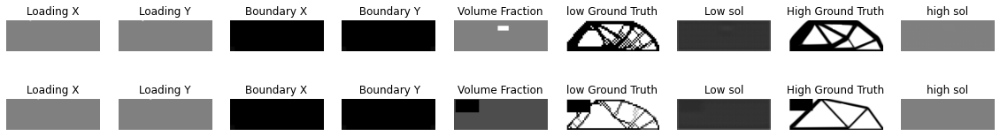

Time for epoch 1 is 6.132410526275635 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.001638,0.00656,0.9512,0.4961]) 


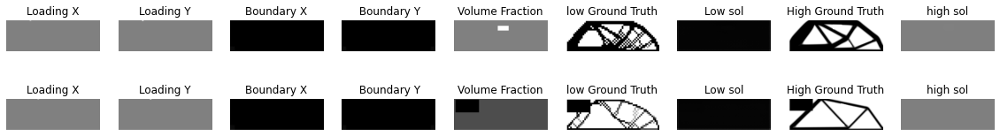

Time for epoch 2 is 5.976656913757324 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.001572,4.31e-05,0.995,0.476]) 


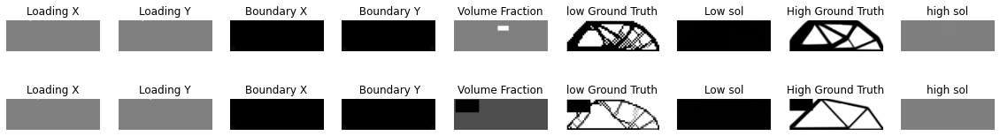

Time for epoch 3 is 6.358709335327148 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.162e-05,2.537e-07,0.9994,0.4612]) 


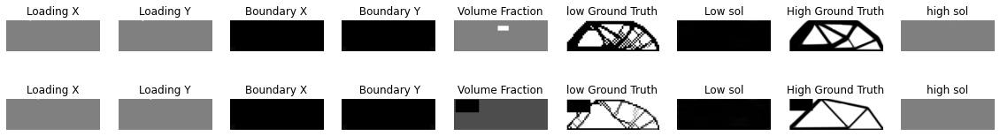

Time for epoch 4 is 6.047330856323242 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.001077,1.035e-08,0.9999,0.4453]) 


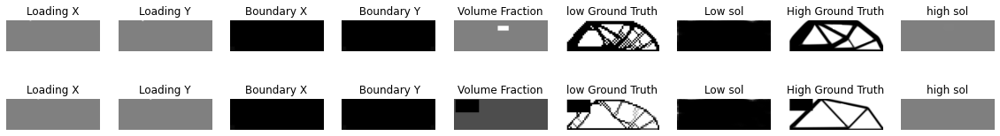

Time for epoch 5 is 6.091014862060547 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.291e-05,7.233e-08,0.9997,0.4048]) 


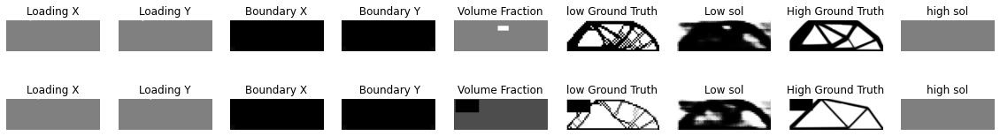

Time for epoch 6 is 6.093542814254761 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.959e-05,3.798e-07,0.9991,0.3489]) 


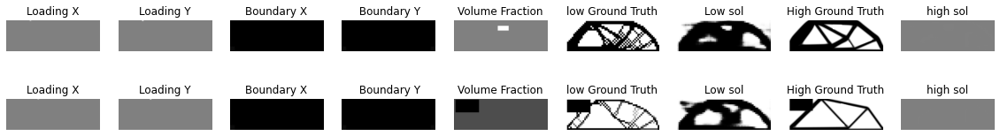

Time for epoch 7 is 6.440395832061768 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [5.313e-06,7.101e-08,0.9998,0.3369]) 


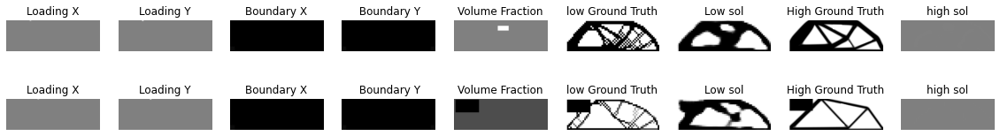

Time for epoch 8 is 6.142336845397949 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.892e-05,3.045e-07,0.9997,0.3229]) 


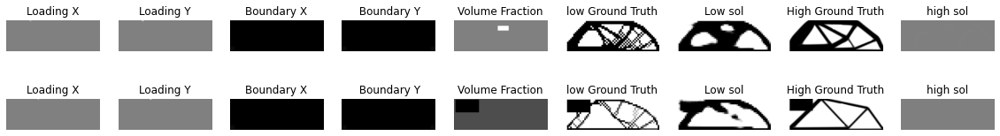

Time for epoch 9 is 6.1687188148498535 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [9.983e-07,7.609e-08,0.9996,0.3137]) 


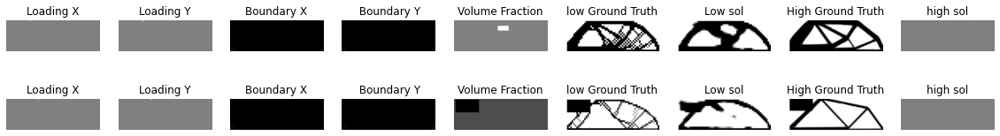

Time for epoch 10 is 6.18204927444458 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.67e-07,4.421e-05,0.9972,0.3017]) 


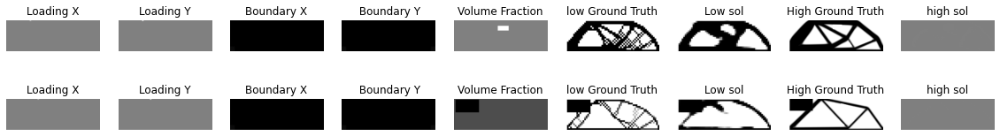

Time for epoch 11 is 6.153287172317505 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [6.29e-06,5.561e-07,0.9993,0.2968]) 


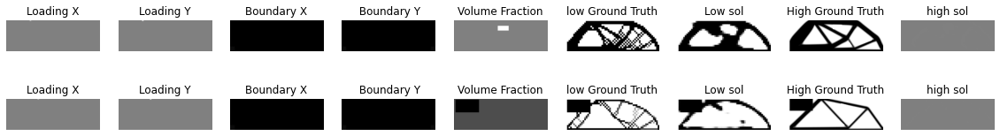

Time for epoch 12 is 6.424161195755005 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.122e-06,3.133e-07,0.9995,0.2853]) 


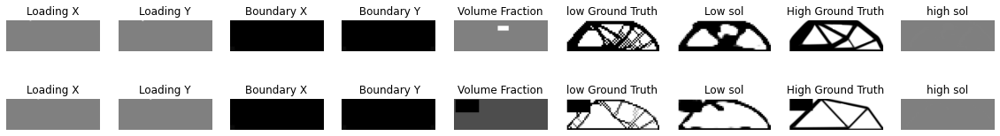

Time for epoch 13 is 6.087164402008057 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.0001899,4.092e-08,0.9998,0.2813]) 


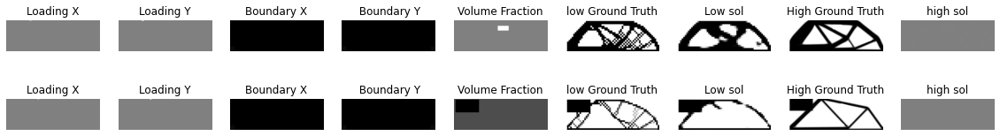

Time for epoch 14 is 6.09375524520874 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.887e-06,1.293e-07,0.9997,0.2677]) 


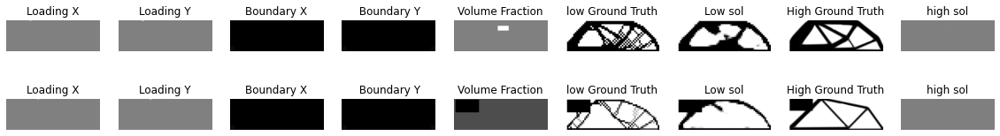

Time for epoch 15 is 6.086782693862915 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.907e-05,3.007e-08,0.9999,0.2521]) 


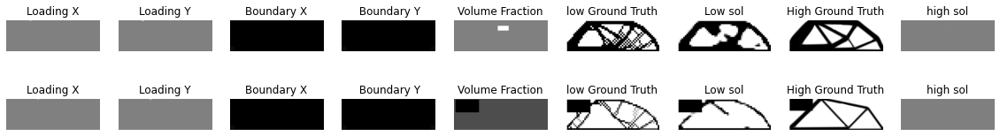

Time for epoch 16 is 6.432378768920898 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [3.203e-07,1.149e-08,0.9999,0.2416]) 


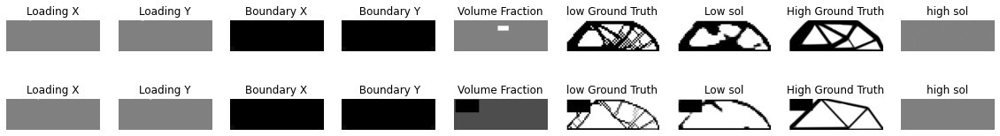

Time for epoch 17 is 6.143794298171997 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.071e-07,4.093e-09,0.9999,0.2339]) 


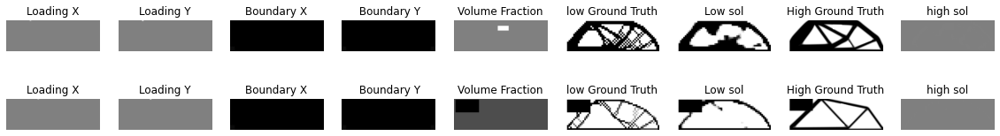

Time for epoch 18 is 6.124103307723999 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.298e-07,1.352e-08,0.9999,0.2275]) 


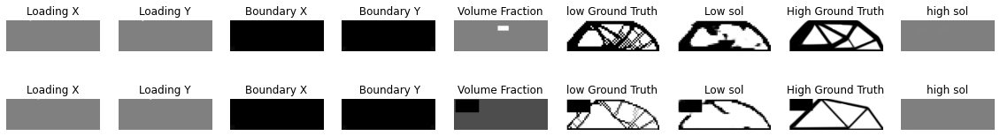

Time for epoch 19 is 6.118007659912109 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.149e-06,1.047e-10,1.0,0.2242]) 
MODEL SAVED


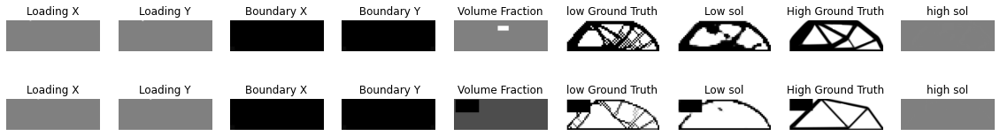

Time for epoch 20 is 6.371736526489258 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [5.484e-06,9.486e-11,1.0,0.2126]) 


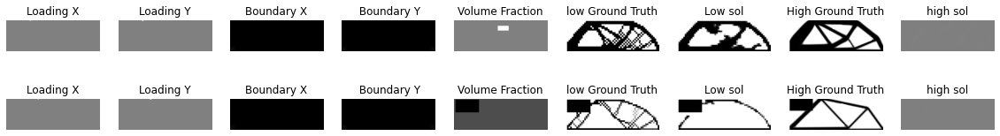

Time for epoch 21 is 6.468112945556641 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.551e-07,1.93e-08,0.9999,0.2035]) 


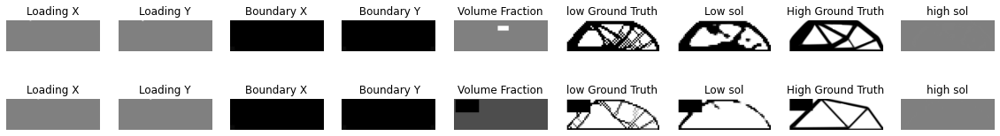

Time for epoch 22 is 6.198074102401733 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [6.047e-06,7.521e-09,0.9999,0.2002]) 


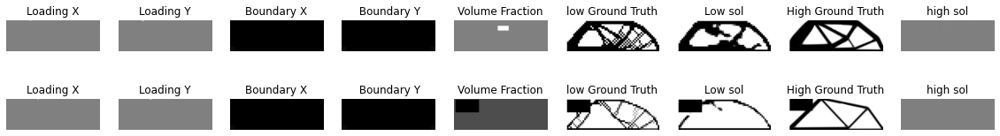

Time for epoch 23 is 6.135047674179077 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.273e-06,4.151e-09,0.9999,0.191]) 


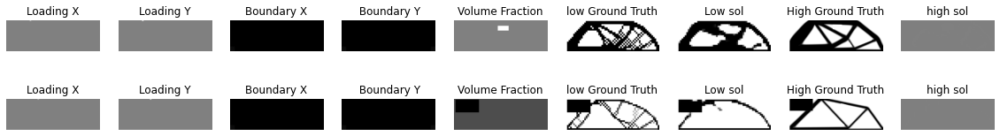

Time for epoch 24 is 6.143721580505371 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [3.422e-07,9.987e-07,0.9994,0.1795]) 


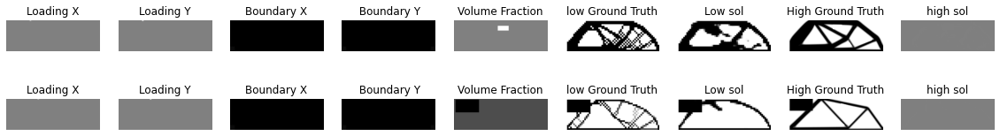

Time for epoch 25 is 6.4116151332855225 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [3.697e-08,4.872e-08,0.9998,0.1803]) 


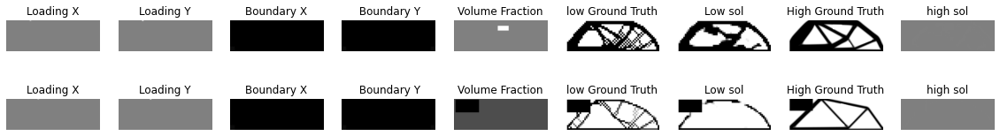

Time for epoch 26 is 6.147051572799683 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.219e-08,9.516e-09,0.9999,0.1738]) 


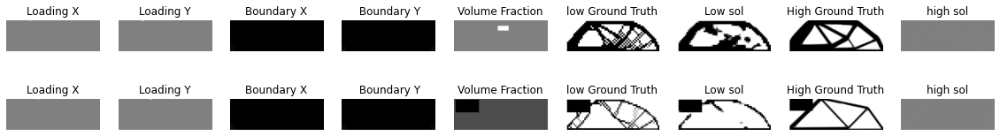

Time for epoch 27 is 6.102951765060425 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.067e-06,8.758e-10,1.0,0.1739]) 


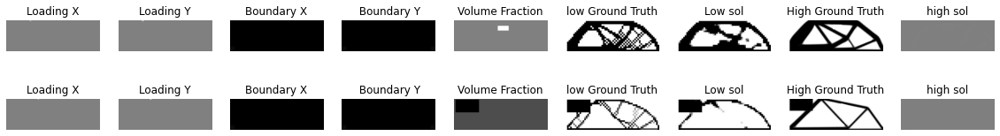

Time for epoch 28 is 6.105353116989136 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.142e-07,7.103e-10,1.0,0.1721]) 


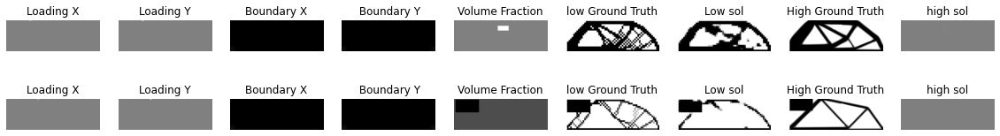

Time for epoch 29 is 6.1186864376068115 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [9.3e-09,2.183e-08,0.9999,0.1714]) 


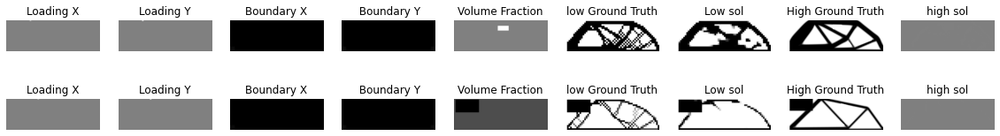

Time for epoch 30 is 6.426157712936401 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.407e-09,1.167e-08,0.9999,0.1676]) 


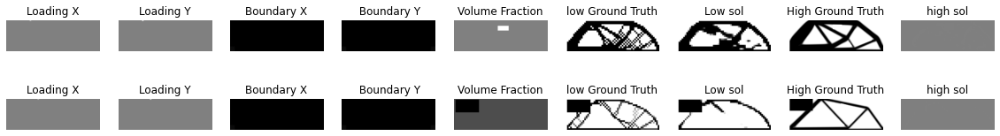

Time for epoch 31 is 6.100405693054199 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.485e-08,2.207e-07,0.9998,0.1614]) 


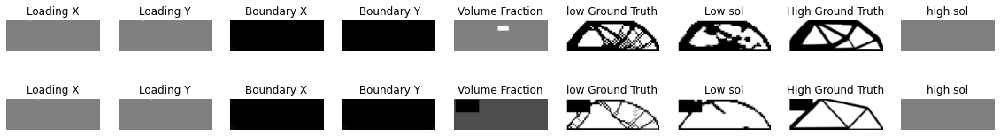

Time for epoch 32 is 6.137038469314575 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [9.132e-09,5.638e-07,0.9997,0.1613]) 


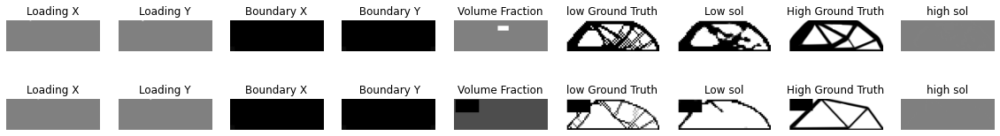

Time for epoch 33 is 6.106469392776489 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.258e-09,7.327e-09,0.9999,0.1619]) 


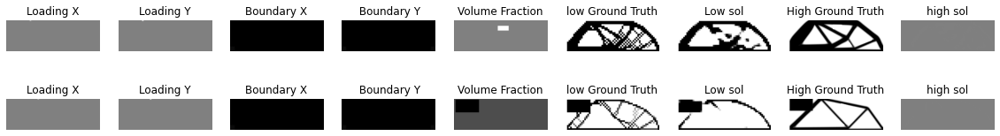

Time for epoch 34 is 6.422055721282959 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [7.192e-09,2.393e-07,0.9996,0.1589]) 


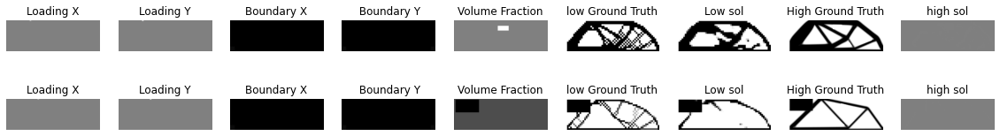

Time for epoch 35 is 6.114736080169678 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.577e-09,5.703e-08,0.9998,0.1562]) 


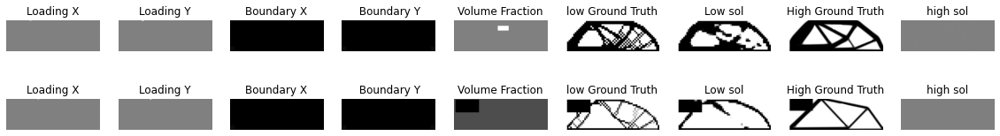

Time for epoch 36 is 6.146580696105957 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.505e-09,1.672e-10,1.0,0.1566]) 


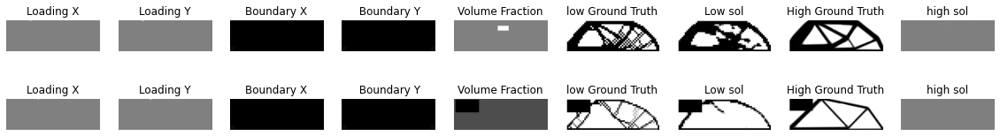

Time for epoch 37 is 6.128344774246216 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.264e-09,7.45e-11,1.0,0.153]) 


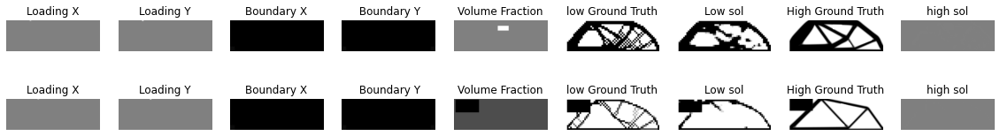

Time for epoch 38 is 6.1283252239227295 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.344e-07,3.369e-11,1.0,0.1514]) 


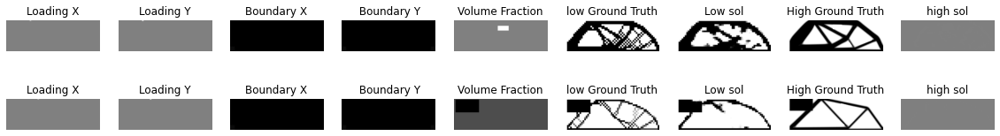

Time for epoch 39 is 6.488369464874268 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.244e-08,1.008e-10,1.0,0.15]) 
MODEL SAVED


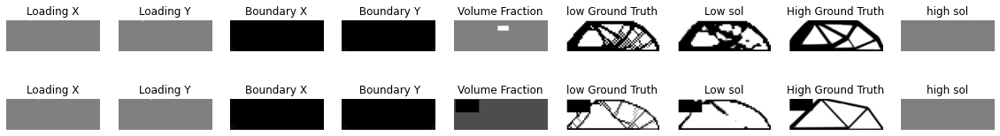

Time for epoch 40 is 6.394841432571411 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.906e-09,7.119e-09,0.9999,0.1479]) 


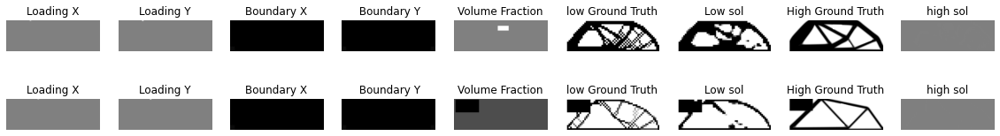

Time for epoch 41 is 6.109660863876343 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [5.385e-10,8.891e-10,1.0,0.1497]) 


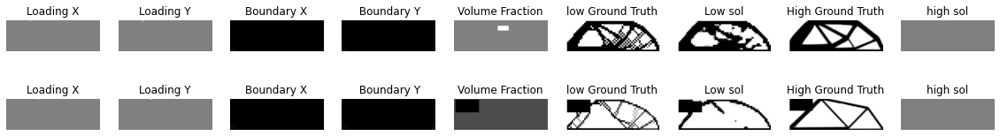

Time for epoch 42 is 6.189023494720459 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.245e-08,2.231e-10,1.0,0.144]) 


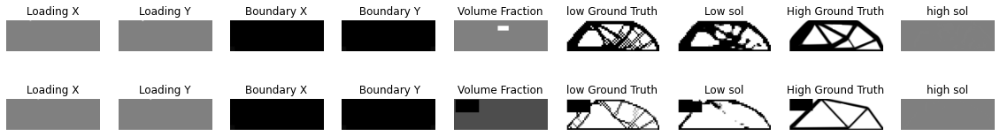

Time for epoch 43 is 6.44582986831665 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [3.296e-09,1.72e-10,1.0,0.1423]) 


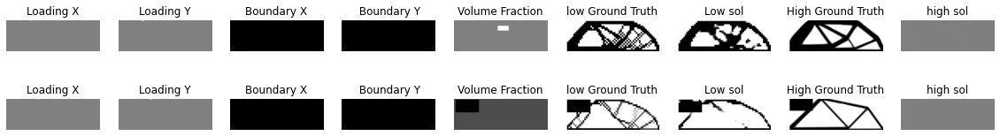

Time for epoch 44 is 6.146910667419434 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.035e-10,1.35e-10,1.0,0.1445]) 


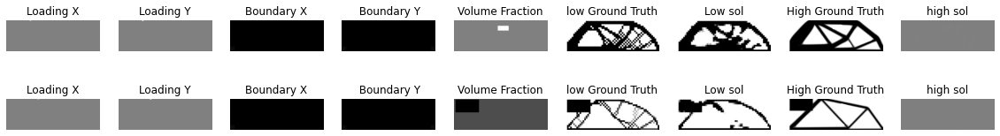

Time for epoch 45 is 6.140399694442749 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.157e-10,1.057e-09,1.0,0.1438]) 


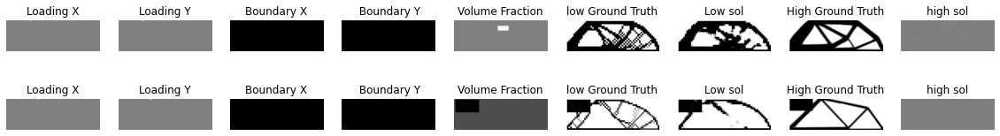

Time for epoch 46 is 6.136414051055908 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [5.305e-11,5.158e-10,1.0,0.1413]) 


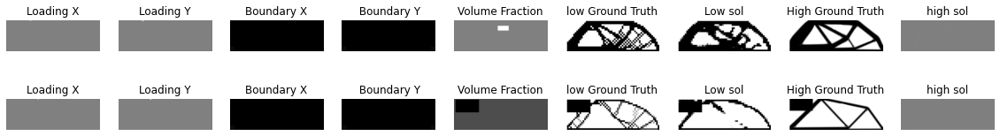

Time for epoch 47 is 6.146409511566162 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.374e-11,1.899e-09,1.0,0.1378]) 


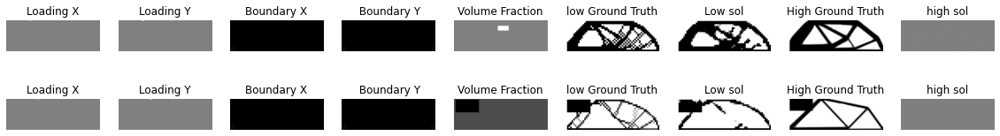

Time for epoch 48 is 6.46582293510437 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.669e-11,3.772e-10,1.0,0.1366]) 


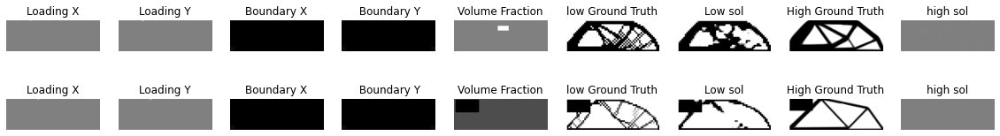

Time for epoch 49 is 6.137833833694458 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [7.678e-11,1.343e-09,1.0,0.1355]) 


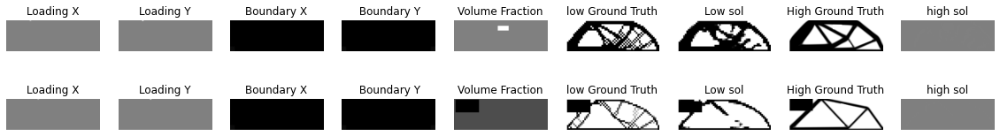

Time for epoch 50 is 6.148264169692993 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [7.411e-11,1.19e-09,1.0,0.1355]) 


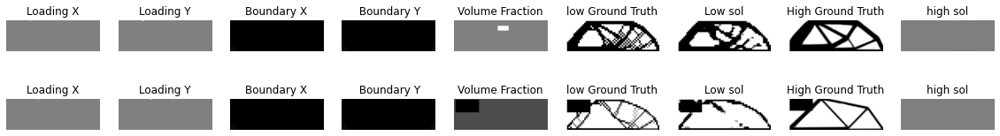

Time for epoch 51 is 6.110503673553467 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.347e-11,1.009e-06,0.9992,0.1372]) 


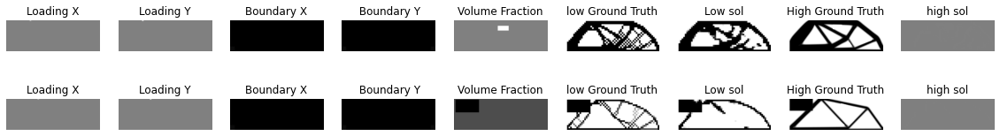

Time for epoch 52 is 6.4273247718811035 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.096e-11,3.454e-08,0.9999,0.1374]) 


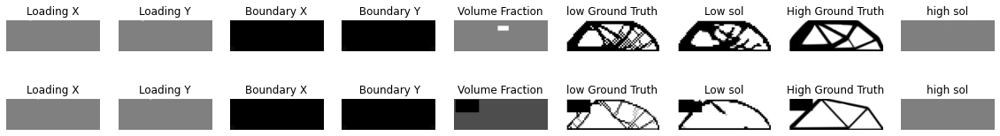

Time for epoch 53 is 6.13133978843689 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.348e-10,2.705e-08,0.9999,0.1287]) 


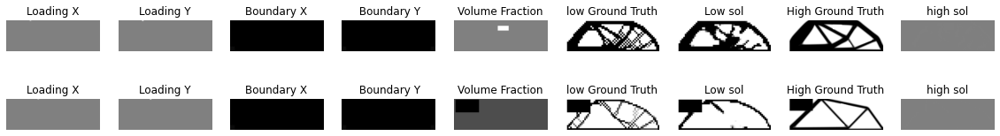

Time for epoch 54 is 6.111152410507202 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.525e-08,1.428e-07,0.9997,0.1333]) 


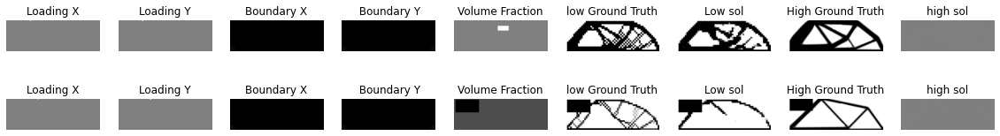

Time for epoch 55 is 6.105835676193237 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.65e-09,0.001586,0.988,0.1315]) 


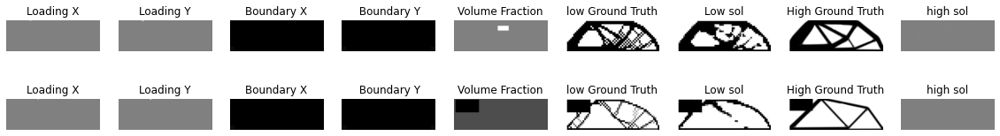

Time for epoch 56 is 6.087742805480957 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [3.232e-06,1.568e-09,1.0,0.1292]) 


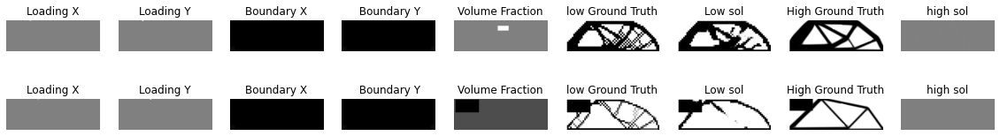

Time for epoch 57 is 6.447869777679443 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [8.293e-08,6.189e-08,0.9998,0.1256]) 


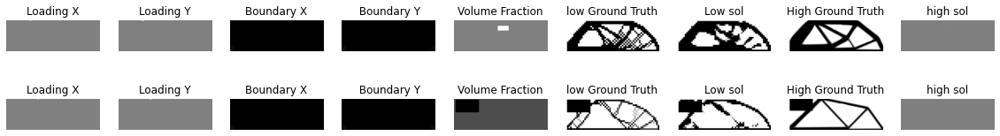

Time for epoch 58 is 6.1277618408203125 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.596e-10,0.09621,0.7722,0.1256]) 


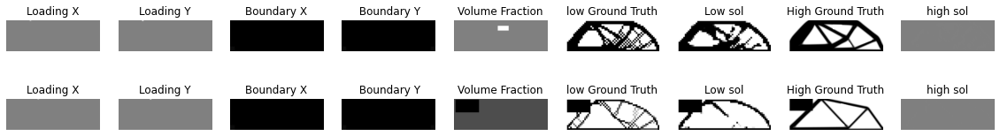

Time for epoch 59 is 6.133691787719727 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [4.314e-08,1.426e-06,0.9988,0.1279]) 
MODEL SAVED


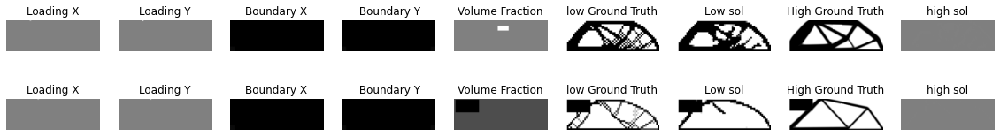

Time for epoch 60 is 6.3551576137542725 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [1.459e-07,4.386e-08,0.9998,0.1264]) 


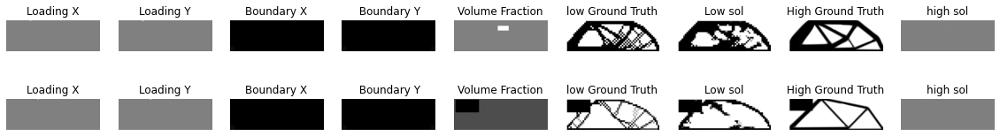

Time for epoch 61 is 6.414910078048706 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [2.313e-05,0.001725,0.9854,0.1259]) 


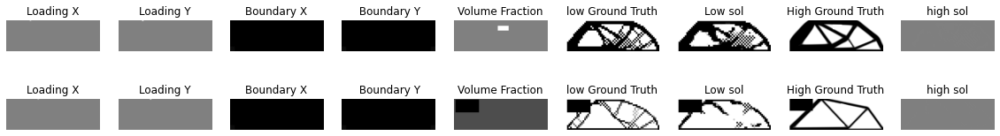

Time for epoch 62 is 6.225717782974243 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.3354,0.1632,0.7185,0.1542]) 


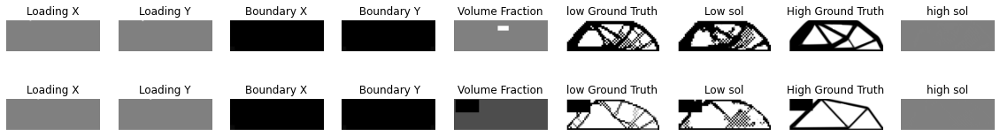

Time for epoch 63 is 6.111638307571411 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.02683,0.554,0.1377,0.1543]) 


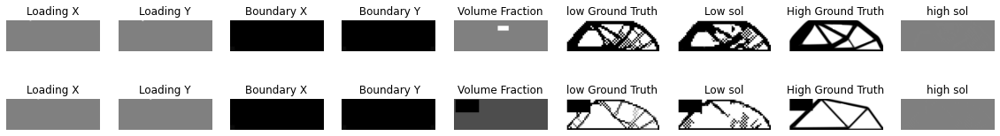

Time for epoch 64 is 6.102276563644409 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03114,0.5705,0.09212,0.1537]) 


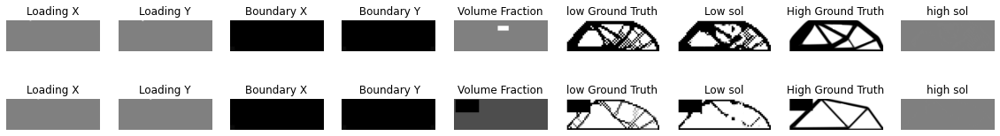

Time for epoch 65 is 6.1230857372283936 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.06151,0.08651,0.6348,0.1459]) 


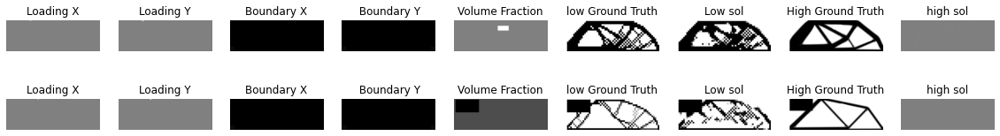

Time for epoch 66 is 6.470444440841675 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.127,0.1393,0.4722,0.1547]) 


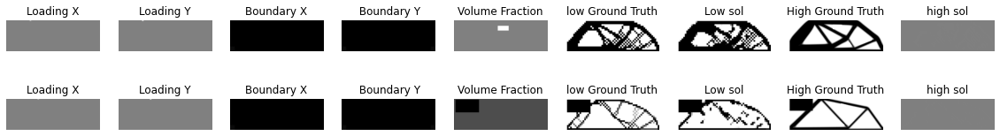

Time for epoch 67 is 6.1444525718688965 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04469,0.1913,0.4133,0.1532]) 


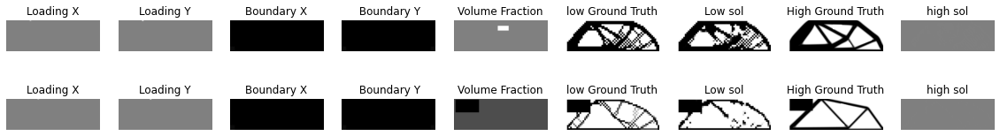

Time for epoch 68 is 6.130500555038452 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.02512,0.2655,0.3565,0.1436]) 


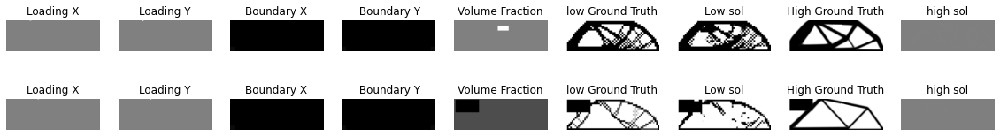

Time for epoch 69 is 6.096237421035767 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.4109,0.02323,0.7772,0.1507]) 


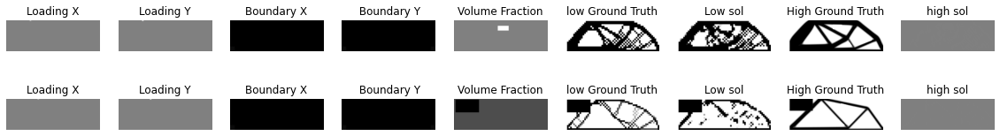

Time for epoch 70 is 6.396859884262085 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.01895,0.4895,0.1306,0.1483]) 


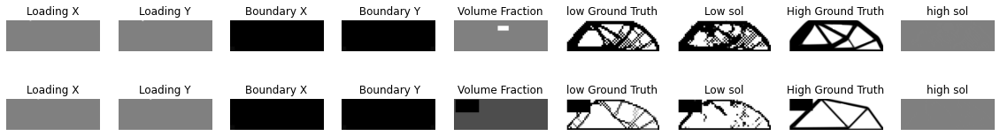

Time for epoch 71 is 6.079116106033325 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.01949,0.4211,0.1706,0.143]) 


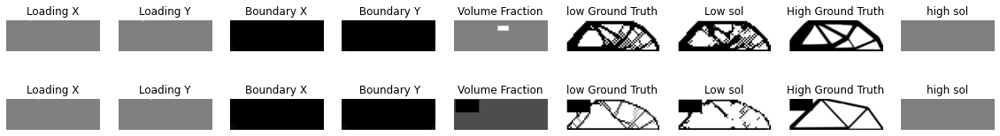

Time for epoch 72 is 6.115888833999634 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.05859,0.2036,0.3675,0.1403]) 


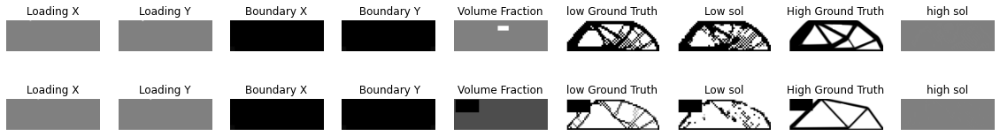

Time for epoch 73 is 6.110098123550415 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.4856,0.0365,0.7097,0.1483]) 


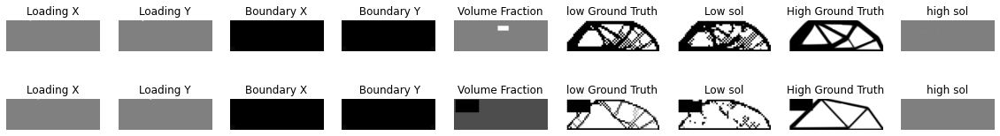

Time for epoch 74 is 6.10723876953125 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.122,0.2169,0.3512,0.1443]) 


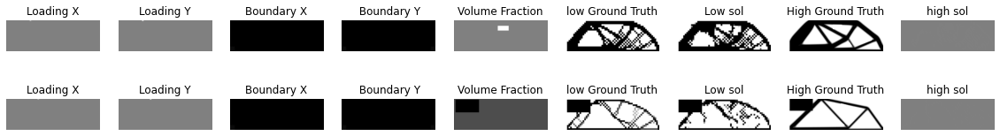

Time for epoch 75 is 6.471398115158081 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03384,0.4063,0.1838,0.1463]) 


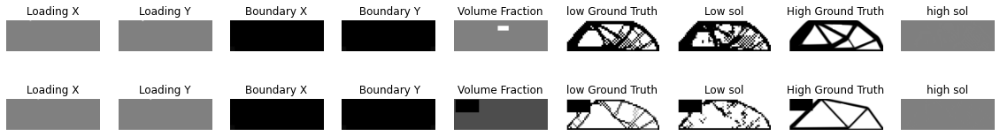

Time for epoch 76 is 6.108075857162476 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.07374,0.3097,0.2534,0.1456]) 


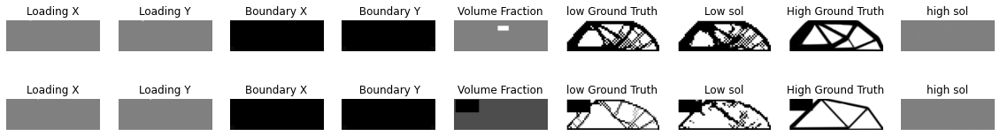

Time for epoch 77 is 6.117597341537476 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04633,0.3111,0.2637,0.1432]) 


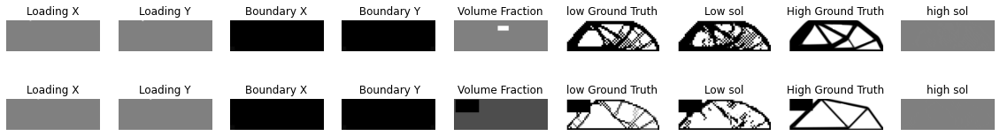

Time for epoch 78 is 6.102745056152344 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1422,0.142,0.4673,0.141]) 


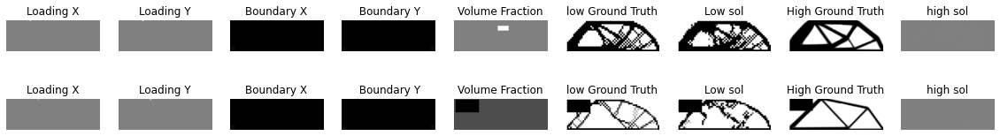

Time for epoch 79 is 6.4041588306427 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.5205,0.0145,0.8365,0.1379]) 
MODEL SAVED


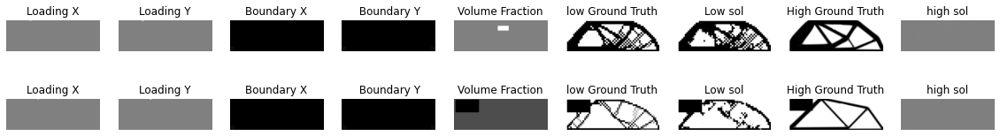

Time for epoch 80 is 6.341087102890015 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03124,0.3292,0.2277,0.133]) 


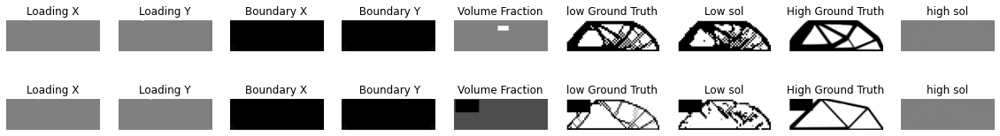

Time for epoch 81 is 6.1835997104644775 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.07622,0.2906,0.2772,0.1344]) 


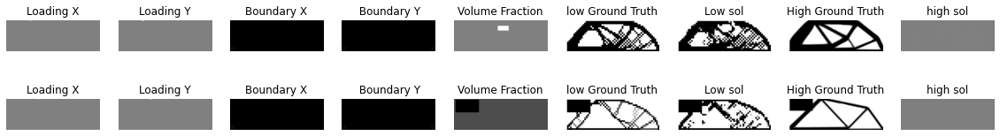

Time for epoch 82 is 6.069221019744873 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1124,0.1809,0.4046,0.1327]) 


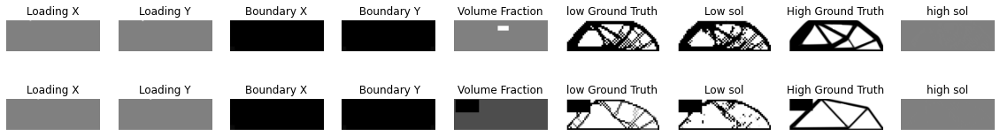

Time for epoch 83 is 6.0944602489471436 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.4412,0.0255,0.781,0.1314]) 


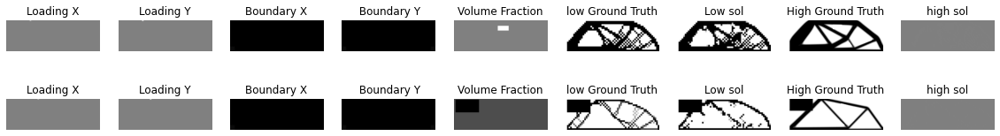

Time for epoch 84 is 6.4166693687438965 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.4618,0.01365,0.8314,0.1263]) 


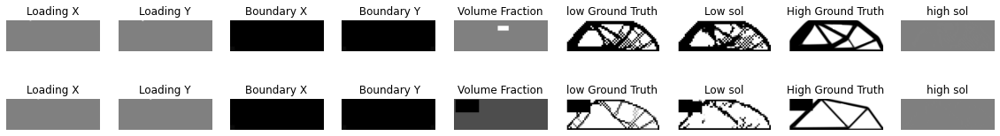

Time for epoch 85 is 6.098099708557129 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.0596,0.199,0.3915,0.1248]) 


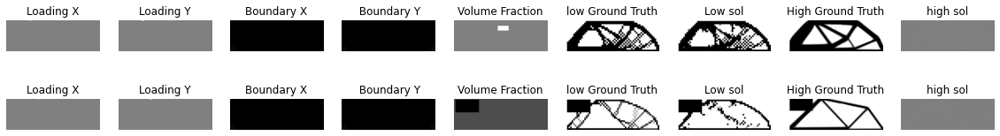

Time for epoch 86 is 6.100167751312256 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.4144,0.02621,0.7776,0.1311]) 


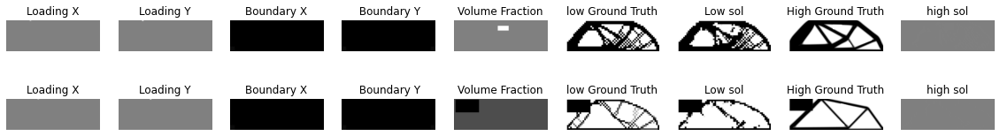

Time for epoch 87 is 6.105224847793579 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04808,0.2189,0.3725,0.1274]) 


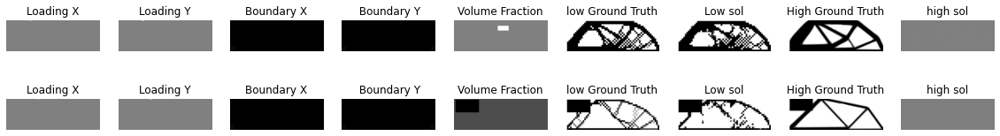

Time for epoch 88 is 6.430854558944702 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.4307,0.01502,0.8336,0.1246]) 


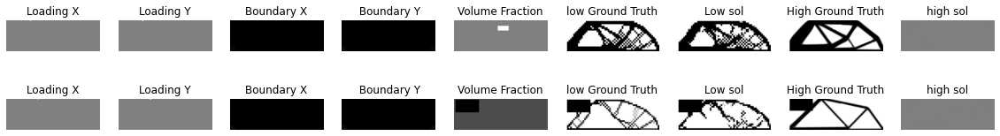

Time for epoch 89 is 6.14839768409729 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.3732,0.0173,0.8234,0.1245]) 


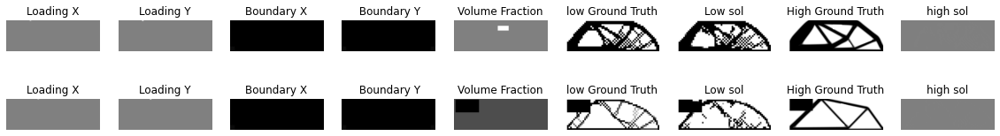

Time for epoch 90 is 6.127367258071899 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.02133,0.3128,0.2556,0.1255]) 


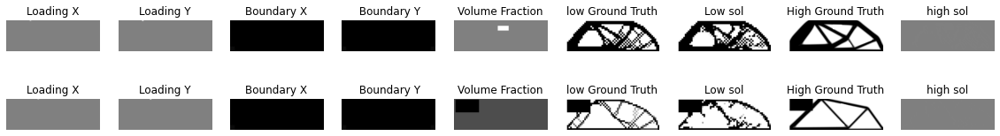

Time for epoch 91 is 6.079404354095459 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1481,0.1125,0.5735,0.1234]) 


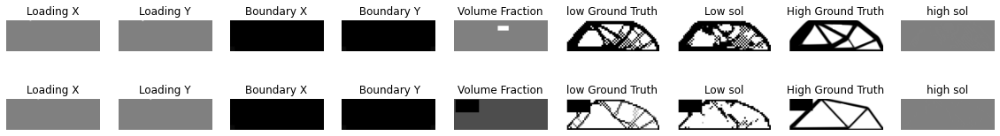

Time for epoch 92 is 6.098162889480591 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04797,0.244,0.3435,0.1228]) 


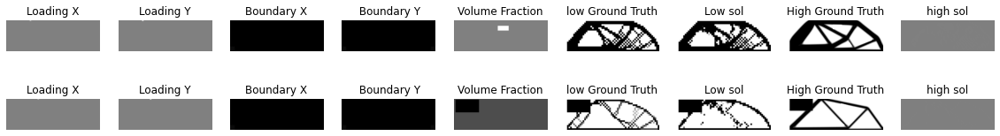

Time for epoch 93 is 6.428704261779785 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.3252,0.0166,0.8494,0.1199]) 


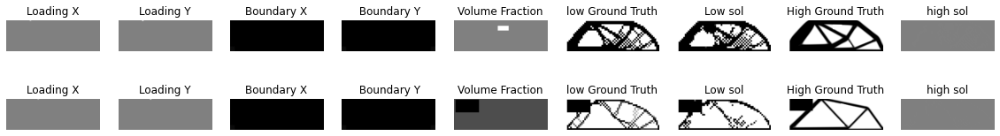

Time for epoch 94 is 6.108682155609131 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04273,0.2015,0.3971,0.1249]) 


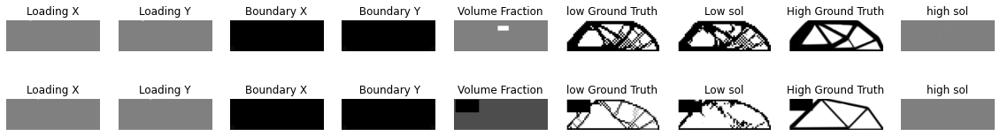

Time for epoch 95 is 6.085480690002441 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.3801,0.01123,0.8373,0.1203]) 


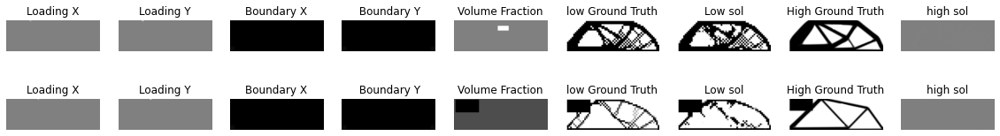

Time for epoch 96 is 6.078101396560669 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03153,0.1691,0.4295,0.1205]) 


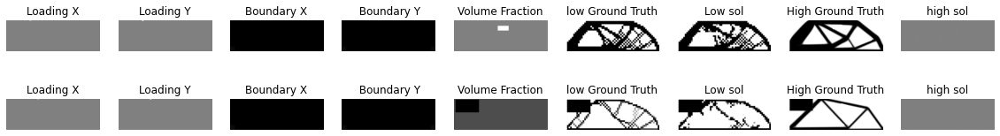

Time for epoch 97 is 6.4115025997161865 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1178,0.09443,0.5973,0.1226]) 


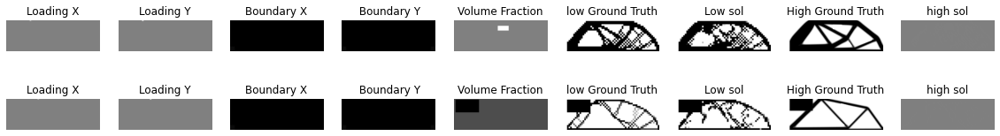

Time for epoch 98 is 6.081387519836426 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.2785,0.03514,0.7229,0.1215]) 


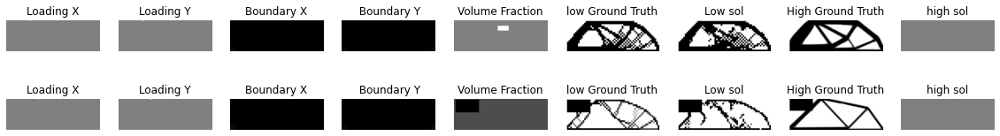

Time for epoch 99 is 6.0979697704315186 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.247,0.02734,0.7623,0.1175]) 
MODEL SAVED


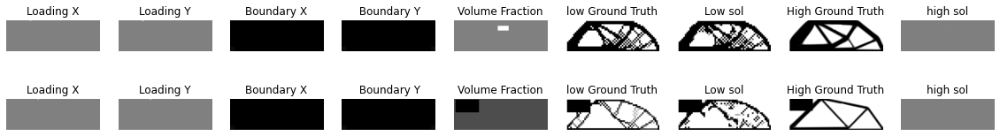

Time for epoch 100 is 6.359433174133301 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04358,0.1838,0.412,0.1139]) 


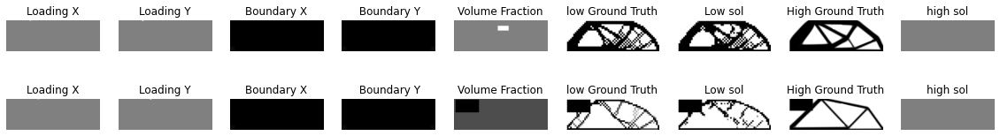

Time for epoch 101 is 6.119648218154907 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.05506,0.1921,0.3963,0.1174]) 


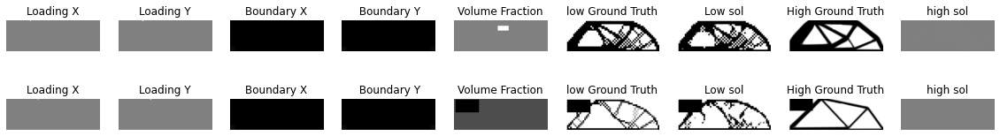

Time for epoch 102 is 6.5673651695251465 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.2601,0.02734,0.7663,0.1127]) 


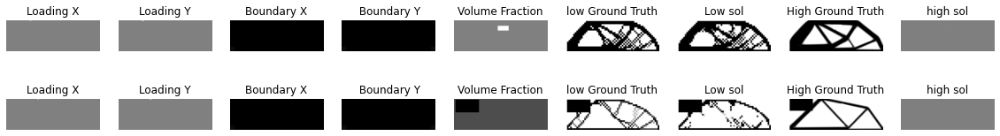

Time for epoch 103 is 6.102540731430054 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04618,0.1538,0.4781,0.1131]) 


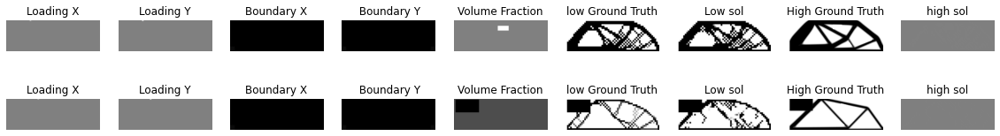

Time for epoch 104 is 6.087958097457886 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.0697,0.1428,0.4953,0.1154]) 


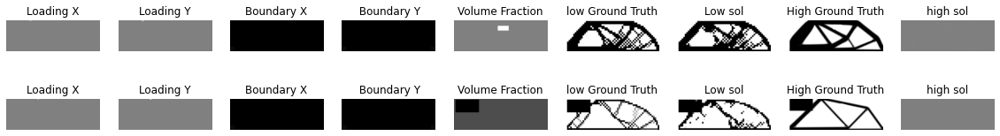

Time for epoch 105 is 6.089712142944336 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1896,0.04153,0.702,0.1144]) 


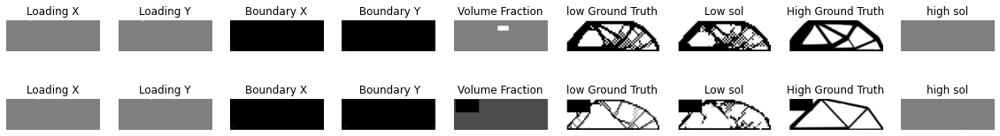

Time for epoch 106 is 6.075144052505493 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.05172,0.1297,0.5238,0.113]) 


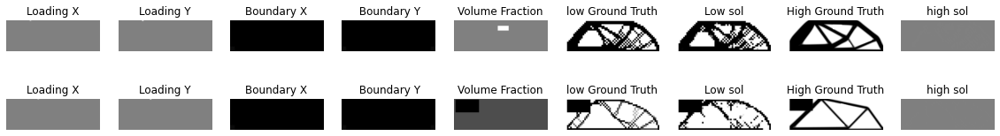

Time for epoch 107 is 6.416098117828369 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.05031,0.1213,0.5139,0.1092]) 


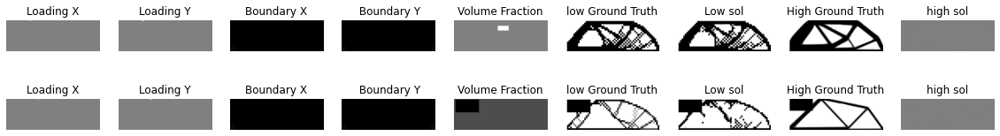

Time for epoch 108 is 6.094365835189819 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.3259,0.01462,0.8258,0.1122]) 


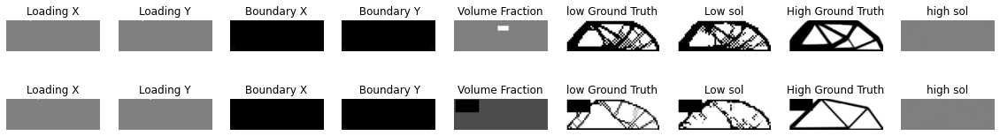

Time for epoch 109 is 6.105869770050049 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.06971,0.1339,0.5393,0.1105]) 


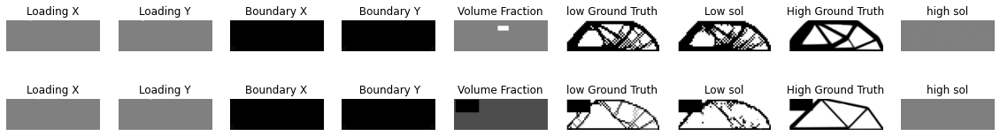

Time for epoch 110 is 6.074591159820557 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.09699,0.06417,0.6552,0.1107]) 


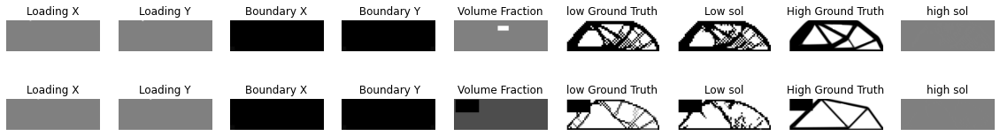

Time for epoch 111 is 6.408674716949463 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1101,0.0546,0.701,0.1081]) 


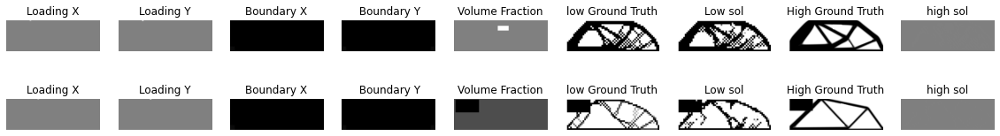

Time for epoch 112 is 6.100767612457275 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.08573,0.05399,0.6391,0.1063]) 


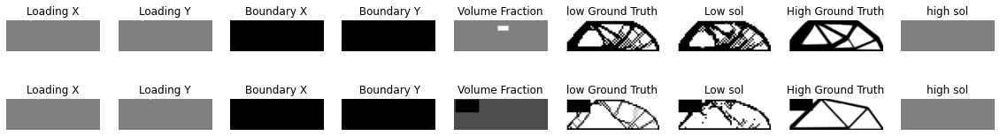

Time for epoch 113 is 6.0891499519348145 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1249,0.02248,0.7864,0.1063]) 


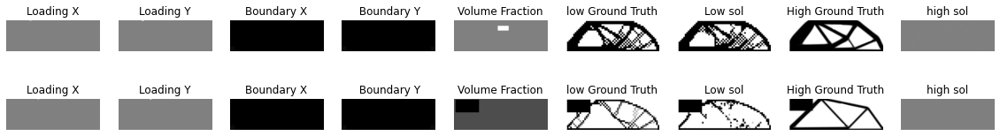

Time for epoch 114 is 6.075364589691162 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1864,0.03081,0.7981,0.1077]) 


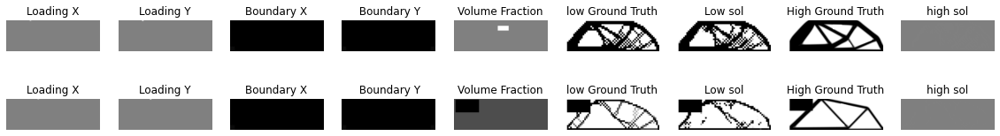

Time for epoch 115 is 6.1199562549591064 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03173,0.1297,0.5126,0.1047]) 


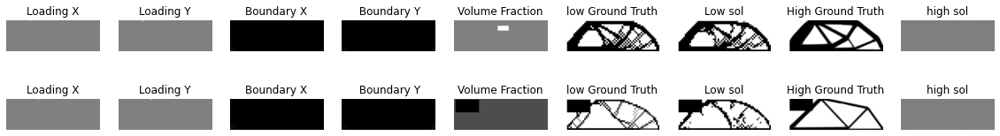

Time for epoch 116 is 6.472439527511597 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.2957,0.01077,0.8598,0.1079]) 


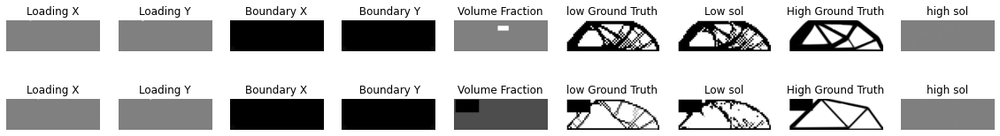

Time for epoch 117 is 6.175475120544434 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.09157,0.05432,0.7184,0.1049]) 


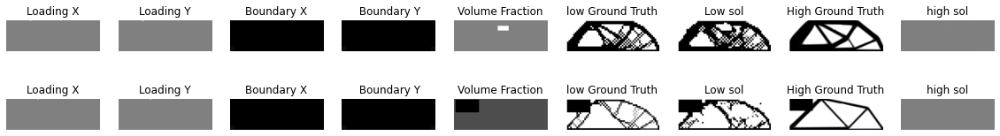

Time for epoch 118 is 6.15173602104187 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.007893,0.2863,0.3271,0.1038]) 


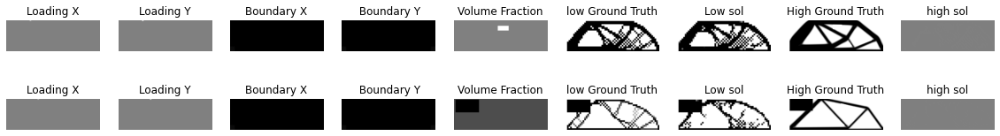

Time for epoch 119 is 6.101009130477905 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04487,0.14,0.4837,0.1013]) 
MODEL SAVED


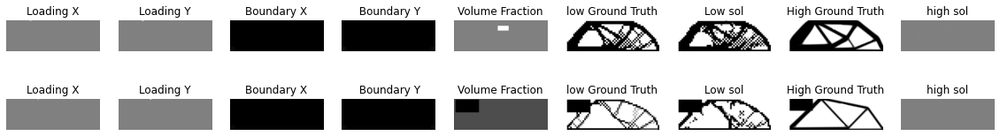

Time for epoch 120 is 6.36859130859375 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.3117,0.009712,0.8663,0.1064]) 


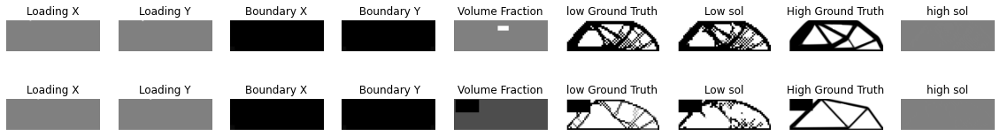

Time for epoch 121 is 6.511868476867676 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.008673,0.1678,0.447,0.09768]) 


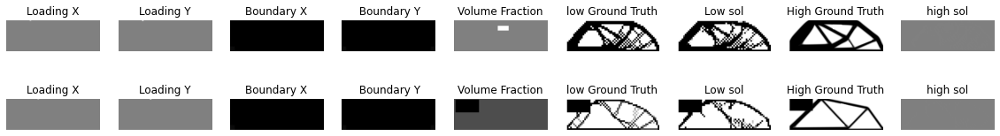

Time for epoch 122 is 6.086242914199829 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1645,0.01445,0.8251,0.09635]) 


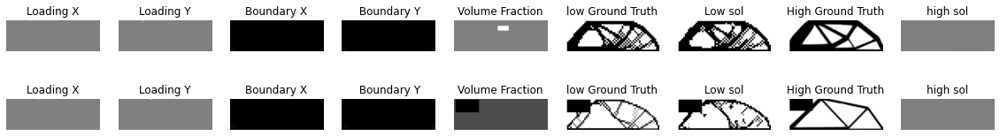

Time for epoch 123 is 6.0955517292022705 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.01314,0.2605,0.3677,0.09379]) 


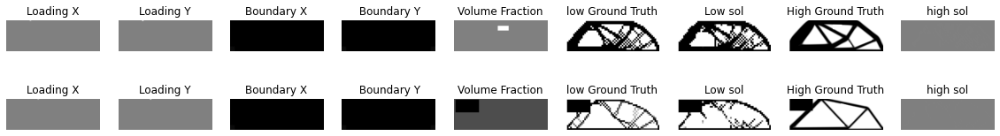

Time for epoch 124 is 6.1191864013671875 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.02534,0.1567,0.5025,0.09744]) 


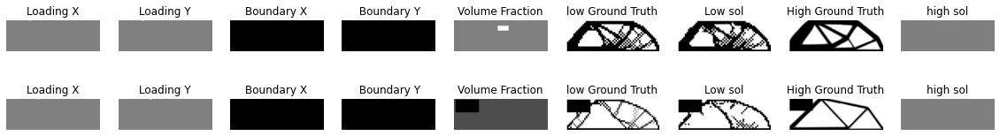

Time for epoch 125 is 6.4174394607543945 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1465,0.01984,0.8059,0.09892]) 


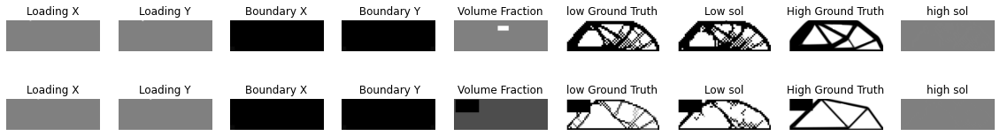

Time for epoch 126 is 6.092683792114258 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.04331,0.09482,0.6175,0.1003]) 


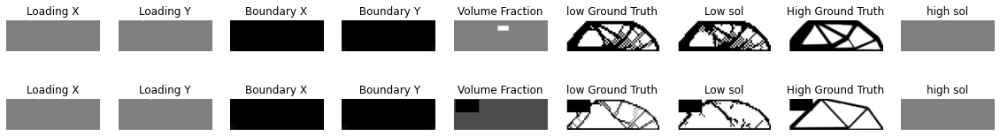

Time for epoch 127 is 6.109064817428589 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1874,0.01686,0.8278,0.09592]) 


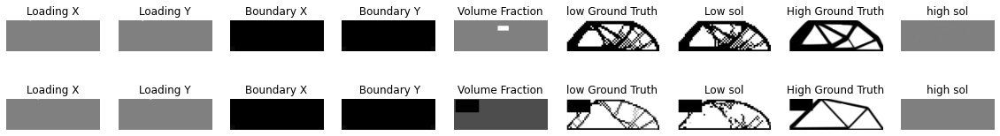

Time for epoch 128 is 6.082383155822754 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03081,0.161,0.4567,0.09745]) 


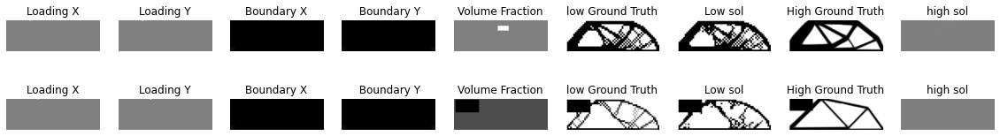

Time for epoch 129 is 6.086313009262085 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1712,0.02899,0.7816,0.09447]) 


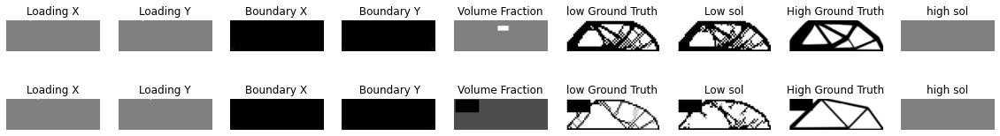

Time for epoch 130 is 6.444763660430908 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.005031,0.3391,0.2857,0.09594]) 


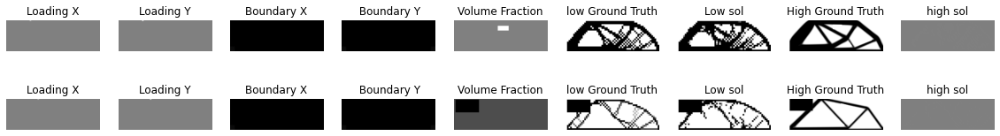

Time for epoch 131 is 6.087396621704102 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.05113,0.05691,0.6723,0.09459]) 


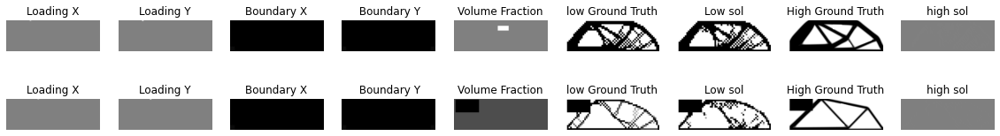

Time for epoch 132 is 6.097919464111328 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.03251,0.1076,0.5519,0.09338]) 


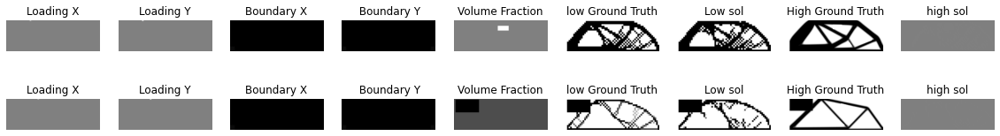

Time for epoch 133 is 6.1148107051849365 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1697,0.01816,0.8208,0.09093]) 


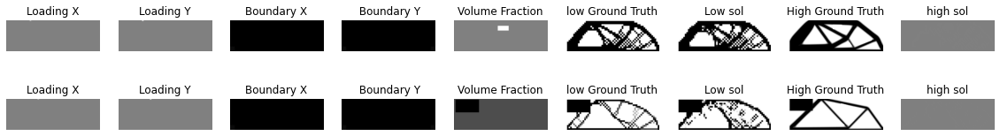

Time for epoch 134 is 6.073373556137085 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.01918,0.1233,0.5357,0.08963]) 


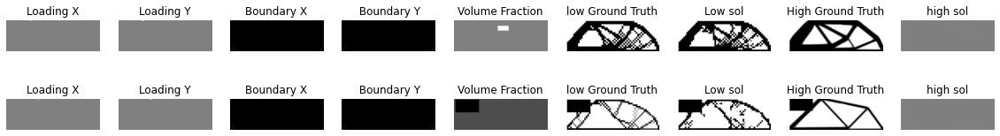

Time for epoch 135 is 6.423067331314087 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1187,0.03185,0.7435,0.09161]) 


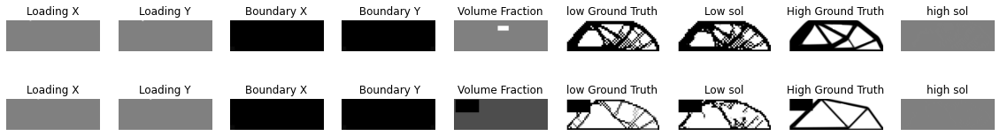

Time for epoch 136 is 6.082183837890625 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1793,0.01695,0.8534,0.09316]) 


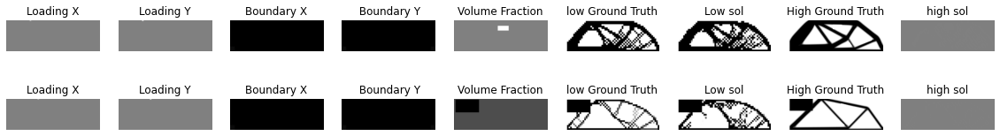

Time for epoch 137 is 6.100413799285889 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.05978,0.06617,0.6833,0.08864]) 


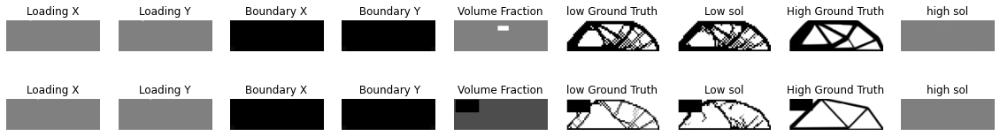

Time for epoch 138 is 6.092959880828857 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.0251,0.116,0.5175,0.08537]) 


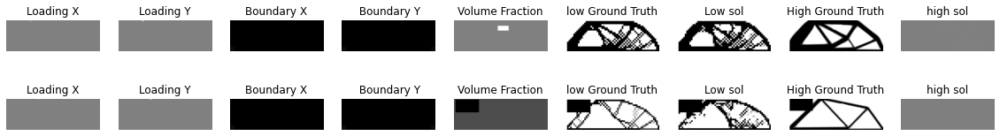

Time for epoch 139 is 6.4159345626831055 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1505,0.02273,0.7993,0.09059]) 
MODEL SAVED


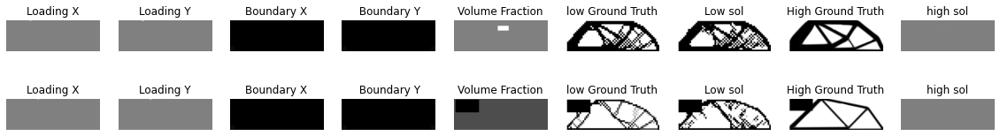

Time for epoch 140 is 6.37259840965271 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.06993,0.06404,0.6973,0.08551]) 


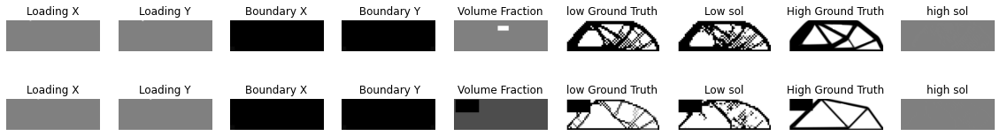

Time for epoch 141 is 6.128303050994873 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.0294,0.1628,0.4618,0.08417]) 


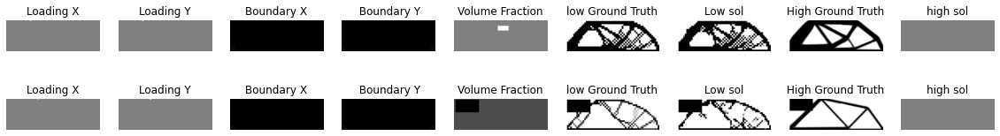

Time for epoch 142 is 6.163246393203735 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1113,0.02672,0.7718,0.08718]) 


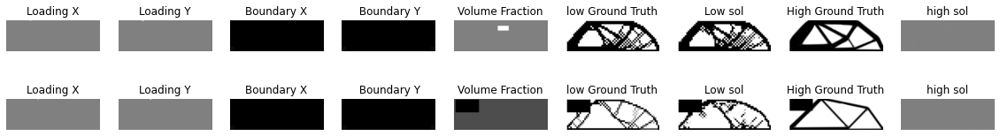

Time for epoch 143 is 6.075376272201538 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.01184,0.2266,0.3718,0.08323]) 


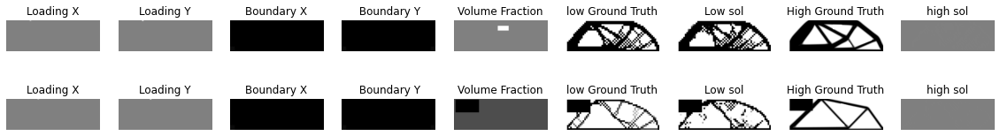

Time for epoch 144 is 6.440934896469116 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.197,0.02029,0.8255,0.08615]) 


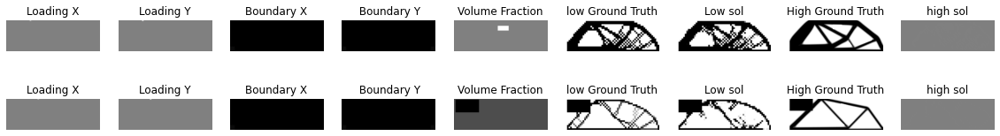

Time for epoch 145 is 6.076223850250244 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.01906,0.1282,0.5311,0.08382]) 


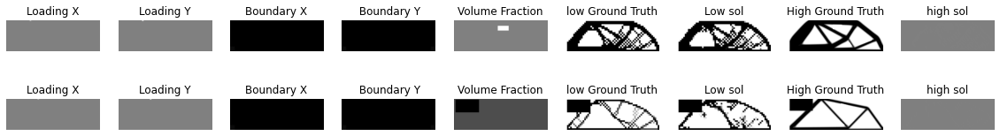

Time for epoch 146 is 6.083759307861328 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1467,0.01691,0.8235,0.084]) 


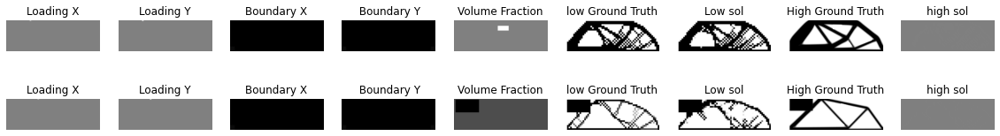

Time for epoch 147 is 6.096374273300171 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.0173,0.2387,0.4092,0.08014]) 


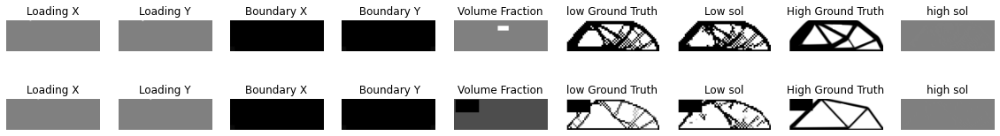

Time for epoch 148 is 6.108898639678955 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.1471,0.02338,0.8218,0.08421]) 


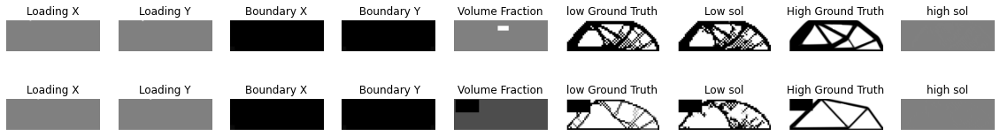

Time for epoch 149 is 6.444299936294556 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.008118,0.1318,0.479,0.08259]) 


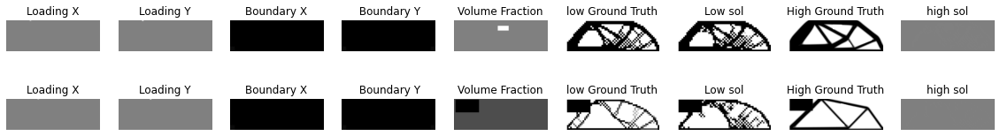

Time for epoch 150 is 6.107967376708984 sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1]: [0.08983,0.03452,0.7639,0.08364]) 


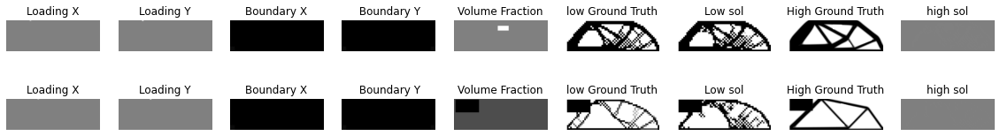

In [ ]:
Loss_mat =  train(low_dataset,150)

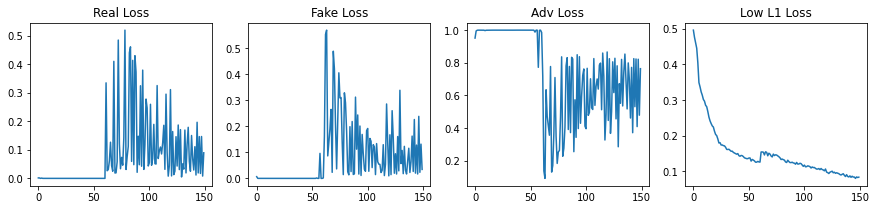

In [ ]:
Lp = np.array(Loss_mat)
plt.figure(figsize=(15,3))
plt.subplot(1,4,1)
plt.title('Real Loss')
plt.plot(Lp[:,0])
plt.subplot(1,4,2)
plt.title('Fake Loss')
plt.plot(Lp[:,1])
plt.subplot(1,4,3)
plt.title('Adv Loss')
plt.plot(Lp[:,2])
plt.subplot(1,4,4)
plt.title('Low L1 Loss')
plt.plot(Lp[:,3])


In [ ]:
import glob
anim_file = 'lgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob("/content/drive/My Drive/Colab Notebooks/LGAN/"+'image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)



In [ ]:
!pip install -q imageio
!pip install -q git+https://github.com/tensorflow/docs


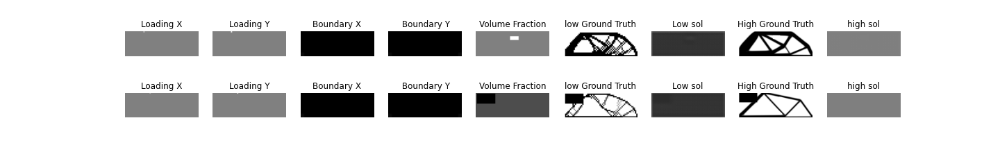

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

In [ ]:
high_dr = '/content/drive/My Drive/Colab Notebooks/HAN'
checkpoint_prefix = os.path.join(high_dr, "ckpt")
# checkpoint = tf.train.Checkpoint(lgen_optimizer = lgen_optimizer,
#                                  hgen_optimizer = hgen_optimizer, ldisc_optimizer = ldisc_optimizer,
#                                  lgen = lgen, hgen = hgen, ldisc= ldisc, CompNET = CompNET)
checkpoint = tf.train.Checkpoint(hgen_optimizer = hgen_optimizer,hgen = hgen)
hgen_optimizer = tf.keras.optimizers.Adam(lr = 2e-4, beta_1 = 0.3, beta_2 = 0.999)

def hgen_train_step(low_img,high_img):

    with tf.GradientTape() as hgen_tape:
      
      # IMAGES
      lowsol = low_img[:,:,:,0:1]
      lowpb = low_img[:,:,:,1:6]

      highsol = high_img[:,:,:,0:1]
      highpb = high_img[:,:,:,1:6]

      # PREDICTION - Generators
      low_pred = lgen(lowpb, training = False)
      high_pred = hgen([highpb,low_pred], training = True)
      
      # L1 LOSS
      high_L1 = lsq(highsol,high_pred)

       # Compliance loss
      comp_real = CompNET([highsol,highpb],training = False)
      comp_fake = CompNET([high_pred,highpb], training = False)
      comp_loss = lsq(comp_real,comp_fake)

      # hgen loss
      hgen_loss =  100*comp_loss + high_L1

      loss_temp = [high_L1,comp_loss,hgen_loss]

 
    gradients_of_hgen = hgen_tape.gradient(hgen_loss, hgen.trainable_variables)
    hgen_optimizer.apply_gradients(zip(gradients_of_hgen, hgen.trainable_variables))
    return loss_temp
    

In [ ]:
import time
def htrain(low_dataset,high_dataset,epochs):
  Loss_mat = []  
  min_loss = 10000


  #BATCH_SIZE = numpy.around(train_data.shape[0]/No_of_batch, decimals = 0)

  for epoch in range(epochs):
    start = time.time()
    

    for (low_img,high_img) in zip(low_dataset,high_dataset):
      
      loss_train = hgen_train_step(low_img,high_img)

 
    # DETERMINING AVG LOSS
    Loss_mat.append(loss_train)
    loss_epoch = np.asarray(loss_train)

    # SAVE THE BEST MODEL ONLY
    loss_epoch = np.array(loss_epoch)
    if loss_epoch[2] < min_loss == 0:
      min_loss = loss_epoch[2]
      checkpoint.save(file_prefix = checkpoint_prefix)
      print('MODEL SAVED')

    # else:
    #   checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
    #display.clear_output(wait=True)
    generate_and_save_images(epoch+1,test,lgen,hgen,ldisc,CompNET,2)
    #print ('Time for epoch {} is {} sec: Training LOSS [real_loss,fake_loss,adv_loss,low_L1,high_L1, comp_loss]: [{:.4},{:.4},{:.4},{:.4},{:.4},{:.4}]) '.format(epoch + 1,time.time()-start,
     #                                                                        loss_epoch[0],loss_epoch[1], loss_epoch[2], loss_epoch[3], loss_epoch[4], loss_epoch[5]))
    print ('Time for epoch {} is {} sec: Training LOSS [highL1,comp_loss,total_loss]: [{:.4},{:.4},{:.4}]) '.format(epoch + 1,time.time()-start,
                                                                            loss_epoch[0],loss_epoch[1],loss_epoch[2]))

  # Generate after the final epoch
  #display.clear_output(wait=True)
  generate_and_save_images(epochs,test,lgen,hgen,ldisc,CompNET,2)
  return Loss_mat


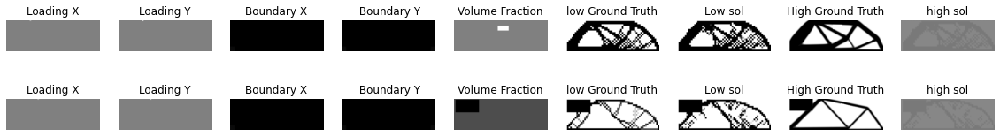

Time for epoch 1 is 40.19234108924866 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.8676,0.001004,0.968]) 


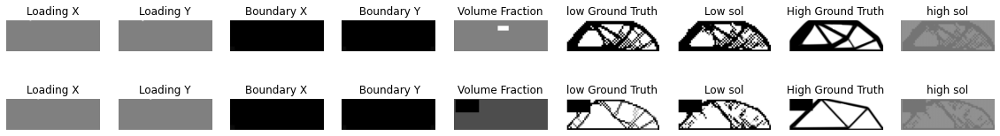

Time for epoch 2 is 37.553359031677246 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.7873,0.001143,0.9016]) 


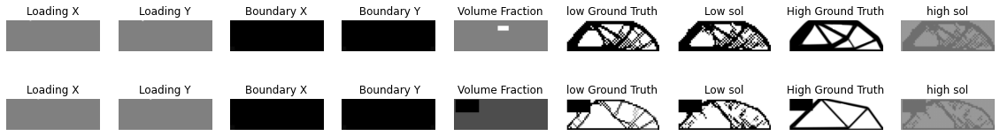

Time for epoch 3 is 37.79996347427368 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.7221,0.0008807,0.8102]) 


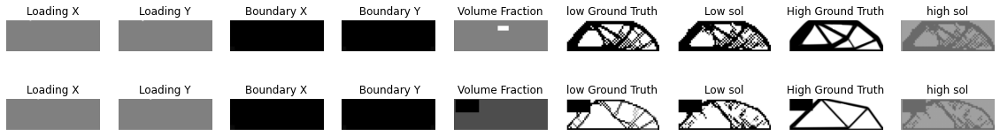

Time for epoch 4 is 37.60311698913574 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.6659,0.0009231,0.7582]) 


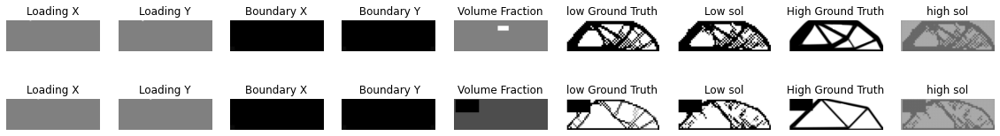

Time for epoch 5 is 37.630143880844116 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.603,0.0005786,0.6608]) 


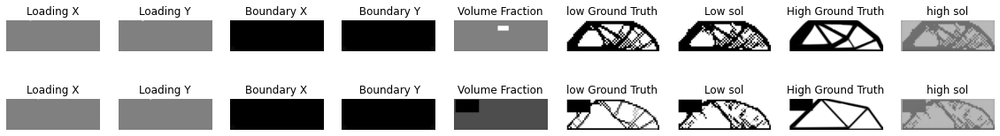

Time for epoch 6 is 37.680246353149414 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.5187,0.0008797,0.6067]) 


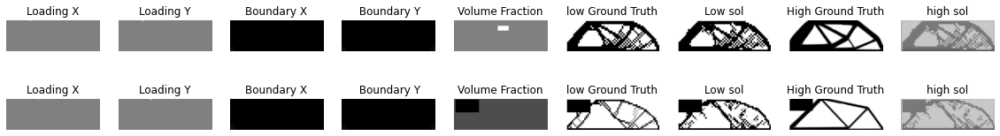

Time for epoch 7 is 38.25975465774536 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.467,0.0004503,0.512]) 


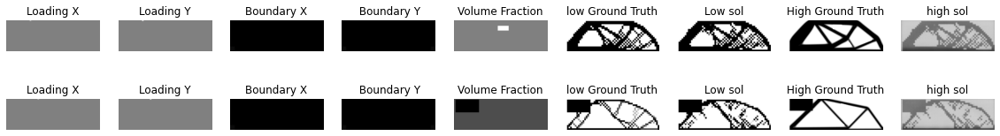

Time for epoch 8 is 37.664294958114624 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.4346,0.000355,0.4701]) 


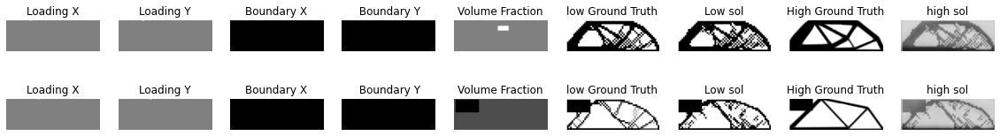

Time for epoch 9 is 37.616740465164185 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.4062,0.0002793,0.4342]) 


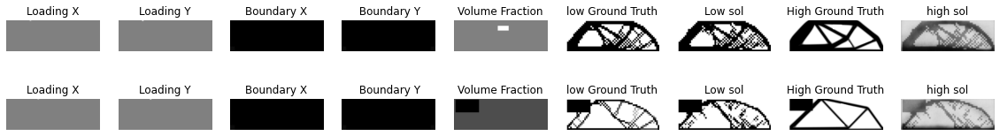

Time for epoch 10 is 37.70607829093933 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3853,0.0005017,0.4355]) 


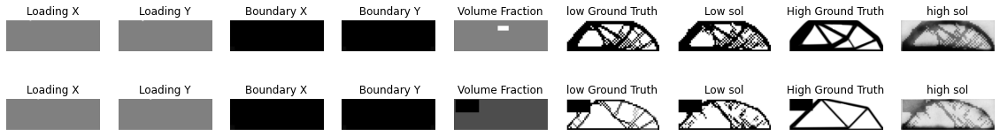

Time for epoch 11 is 37.69274187088013 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3703,0.0004625,0.4165]) 


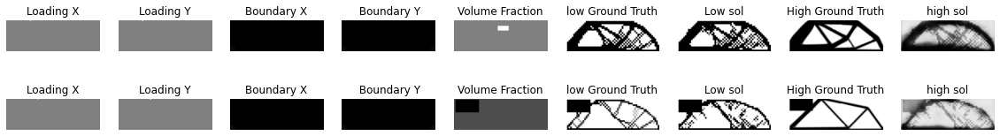

Time for epoch 12 is 37.69883942604065 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3545,0.0004463,0.3991]) 


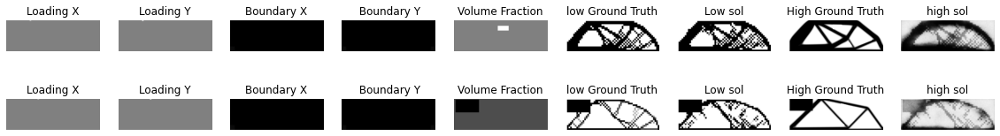

Time for epoch 13 is 37.64947247505188 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3445,0.0002713,0.3716]) 


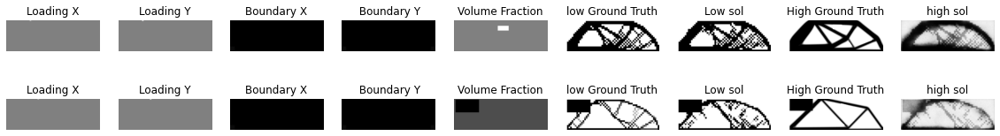

Time for epoch 14 is 38.36879062652588 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3363,0.0002395,0.3602]) 


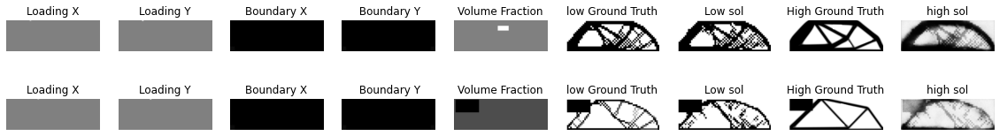

Time for epoch 15 is 37.7246778011322 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3239,0.0002208,0.346]) 


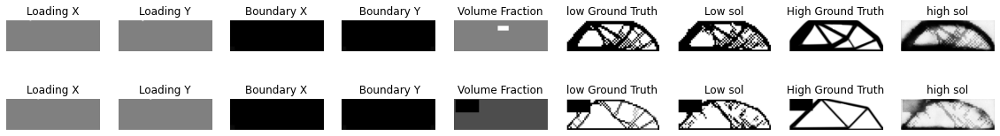

Time for epoch 16 is 37.63087701797485 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3191,0.0002054,0.3396]) 


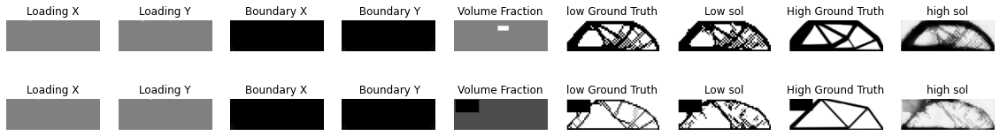

Time for epoch 17 is 37.7208948135376 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3132,0.0001371,0.3269]) 


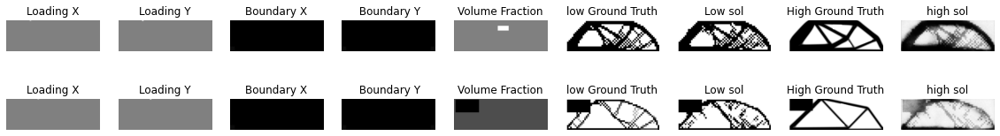

Time for epoch 18 is 37.719651222229004 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3074,0.0002573,0.3331]) 


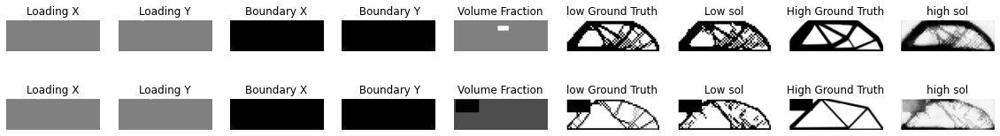

Time for epoch 19 is 37.683247804641724 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3037,0.0006296,0.3667]) 


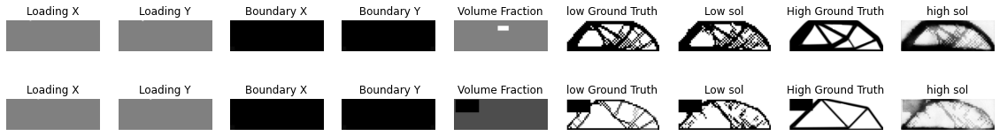

Time for epoch 20 is 38.407854318618774 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2999,0.0004524,0.3451]) 


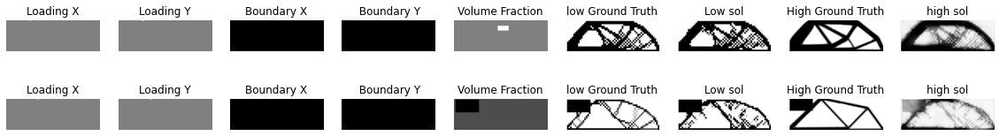

Time for epoch 21 is 37.764830350875854 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2935,0.0004406,0.3376]) 


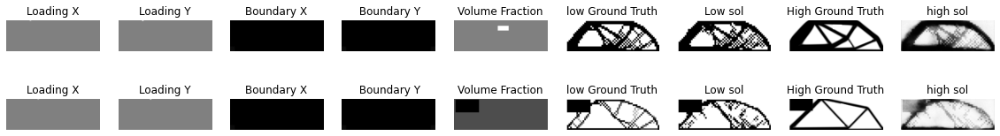

Time for epoch 22 is 37.67898440361023 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2933,6.205e-05,0.2995]) 


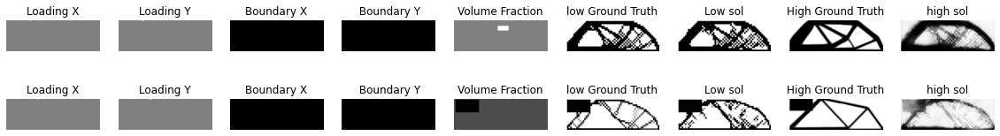

Time for epoch 23 is 37.69143080711365 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2899,0.0001973,0.3096]) 


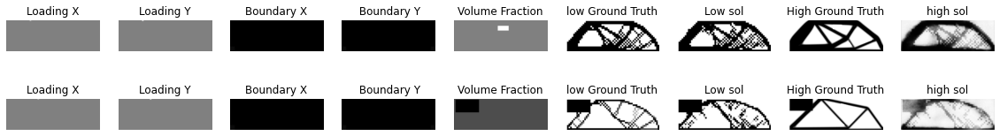

Time for epoch 24 is 37.69992184638977 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2924,0.0002908,0.3215]) 


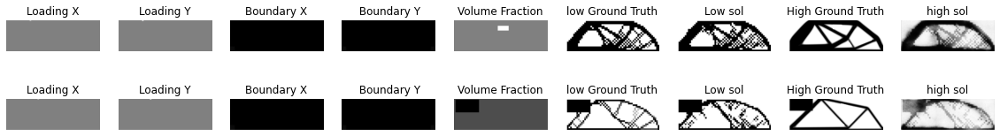

Time for epoch 25 is 37.67189049720764 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.3109,0.0007163,0.3825]) 


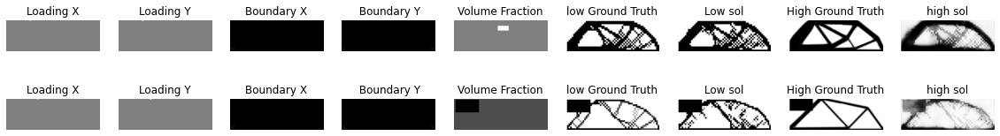

Time for epoch 26 is 37.669686794281006 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2893,0.0002828,0.3176]) 


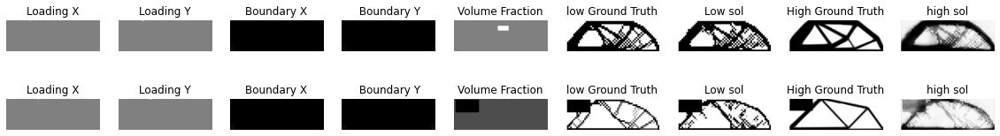

Time for epoch 27 is 38.29771327972412 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2856,0.0003208,0.3177]) 


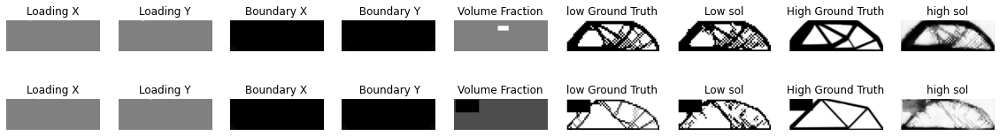

Time for epoch 28 is 37.68595361709595 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2789,0.0002983,0.3087]) 


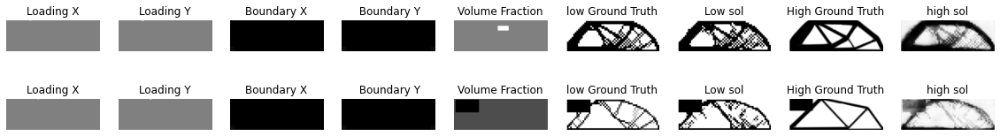

Time for epoch 29 is 37.66606259346008 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2745,0.0003228,0.3068]) 


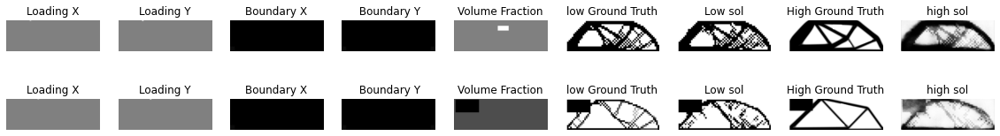

Time for epoch 30 is 37.675742387771606 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2715,9.65e-05,0.2812]) 


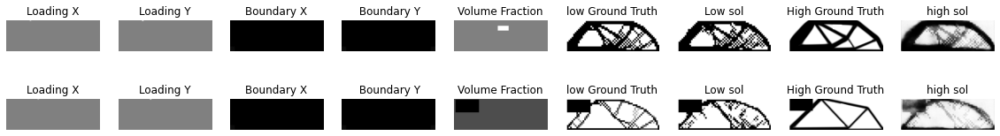

Time for epoch 31 is 37.77400779724121 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2669,0.0001422,0.2811]) 


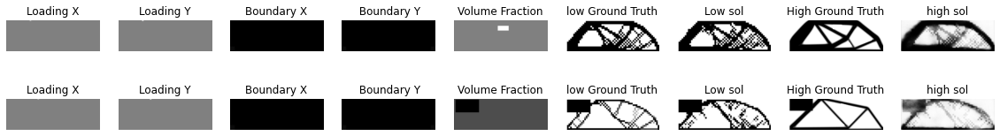

Time for epoch 32 is 37.73289775848389 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2662,3.847e-05,0.27]) 


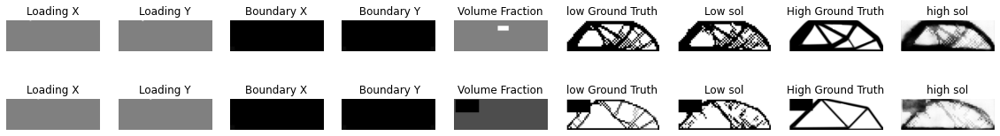

Time for epoch 33 is 37.76674222946167 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2614,7.096e-05,0.2685]) 


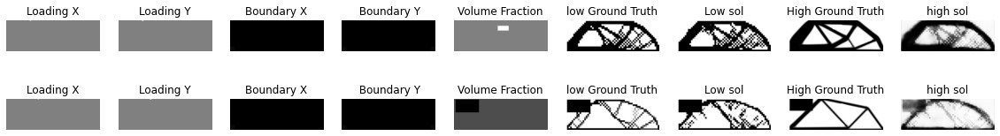

Time for epoch 34 is 38.58951950073242 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2574,9.97e-05,0.2673]) 


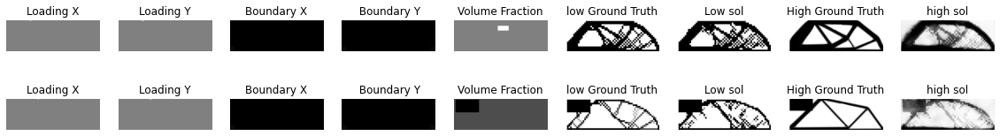

Time for epoch 35 is 37.965545654296875 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2652,0.0002907,0.2942]) 


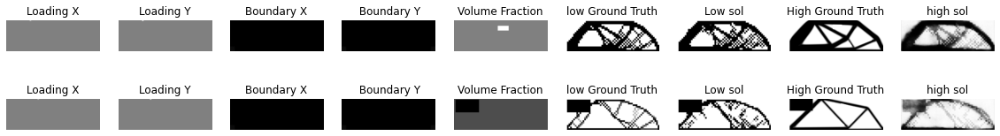

Time for epoch 36 is 37.92763113975525 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2611,0.0003093,0.292]) 


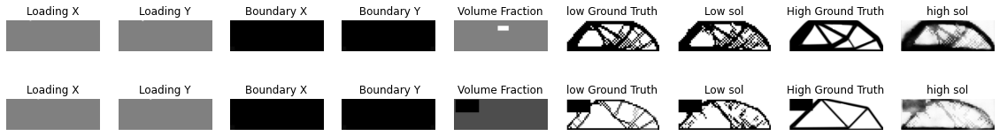

Time for epoch 37 is 37.84516930580139 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.257,0.0003531,0.2923]) 


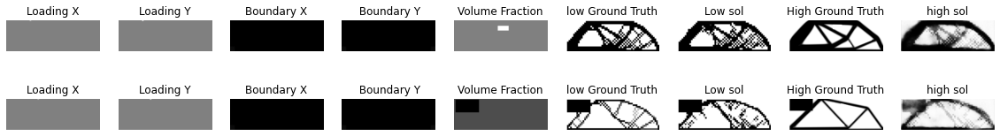

Time for epoch 38 is 37.834699630737305 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2504,0.0001455,0.265]) 


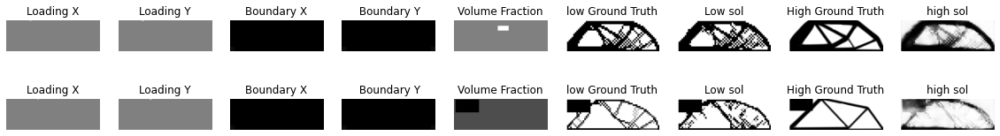

Time for epoch 39 is 37.85646176338196 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2513,0.0003449,0.2858]) 


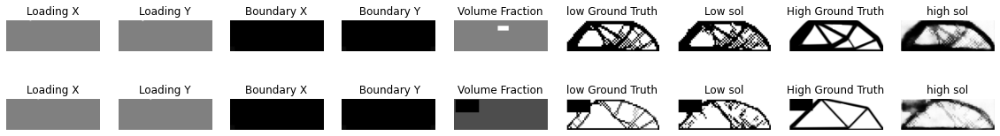

Time for epoch 40 is 38.51975345611572 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2488,0.0001309,0.2619]) 


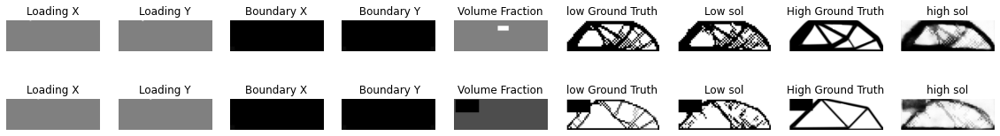

Time for epoch 41 is 37.85270357131958 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2471,0.0001069,0.2578]) 


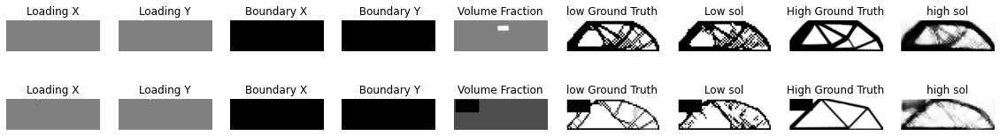

Time for epoch 42 is 37.94973635673523 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2422,0.0001777,0.2599]) 


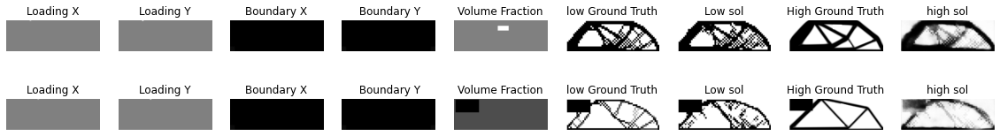

Time for epoch 43 is 37.76569867134094 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2422,0.0001735,0.2596]) 


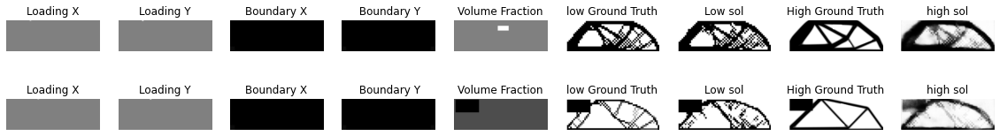

Time for epoch 44 is 37.82342505455017 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2365,0.0003049,0.267]) 


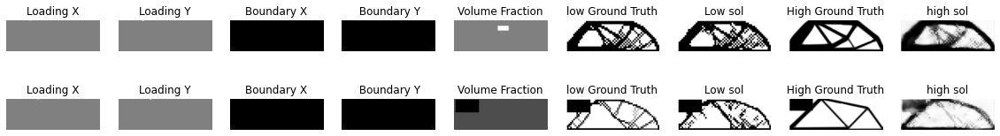

Time for epoch 45 is 37.89643597602844 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.234,0.0002769,0.2616]) 


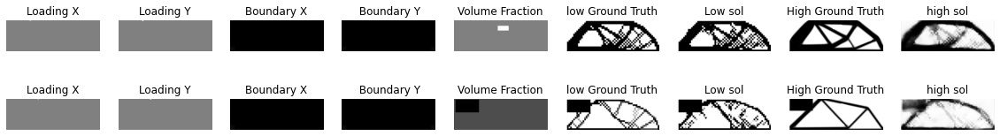

Time for epoch 46 is 38.52455711364746 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2325,0.0001274,0.2452]) 


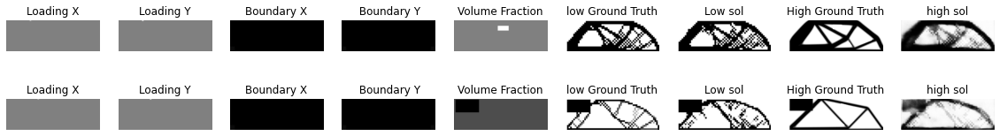

Time for epoch 47 is 37.89935493469238 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2302,0.0002379,0.254]) 


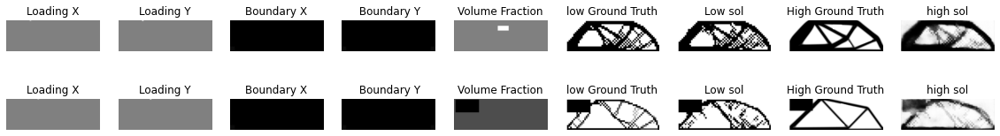

Time for epoch 48 is 37.838852405548096 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2283,0.0002305,0.2514]) 


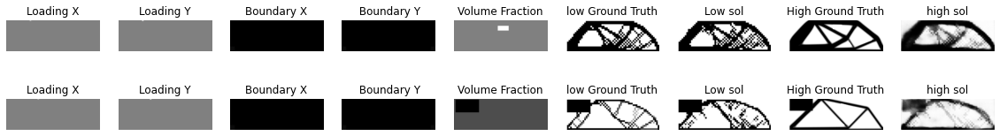

Time for epoch 49 is 37.80615758895874 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2242,8.439e-05,0.2326]) 


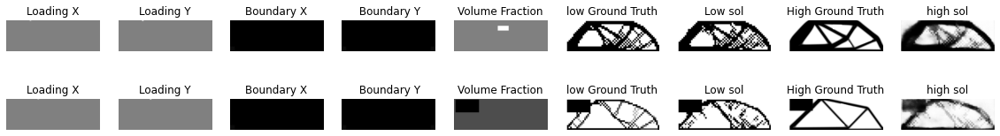

Time for epoch 50 is 37.80854272842407 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2221,0.0001857,0.2407]) 


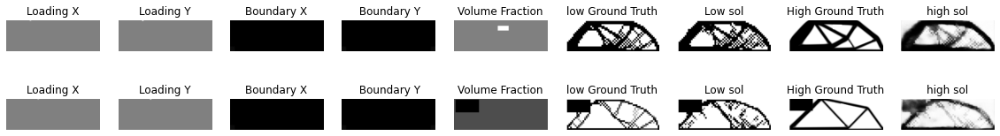

Time for epoch 51 is 37.84844708442688 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2233,0.0002728,0.2505]) 


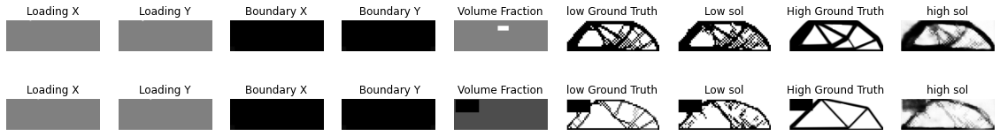

Time for epoch 52 is 37.857584714889526 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2196,5.334e-05,0.2249]) 


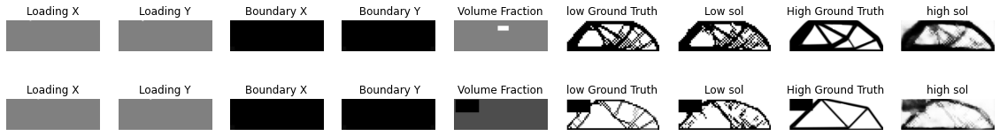

Time for epoch 53 is 38.58342909812927 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2183,0.000186,0.2369]) 


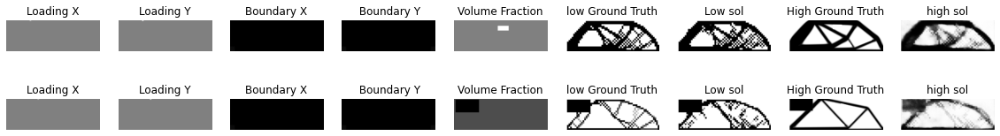

Time for epoch 54 is 37.85202884674072 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2195,0.0002725,0.2468]) 


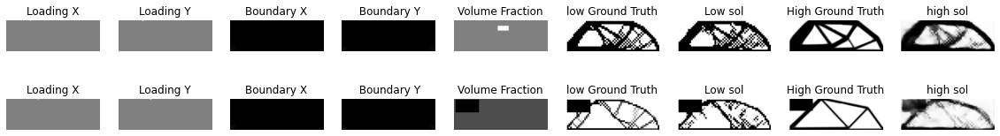

Time for epoch 55 is 37.857810974121094 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2296,0.0001003,0.2396]) 


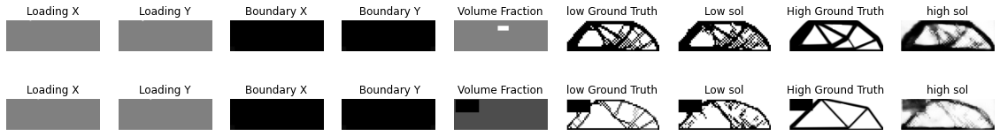

Time for epoch 56 is 37.80503702163696 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2279,0.0001787,0.2458]) 


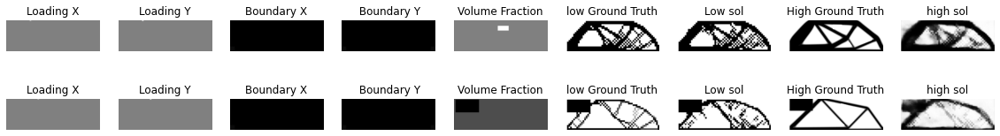

Time for epoch 57 is 37.851900815963745 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2199,0.0001885,0.2387]) 


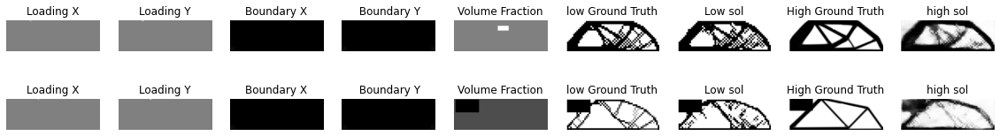

Time for epoch 58 is 37.812347412109375 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2163,0.0002005,0.2363]) 


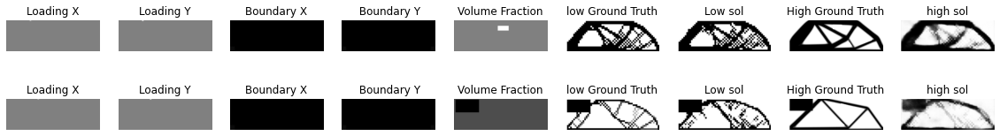

Time for epoch 59 is 37.88322901725769 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2145,0.0001966,0.2342]) 


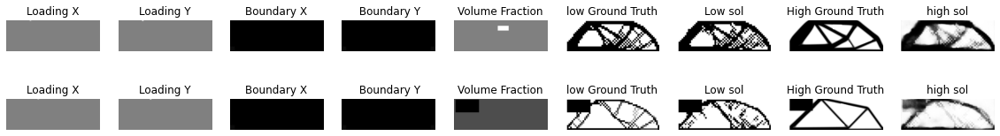

Time for epoch 60 is 38.51766490936279 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2167,0.0002287,0.2395]) 


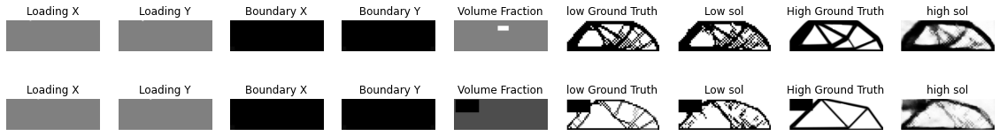

Time for epoch 61 is 37.890170097351074 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2087,0.0001255,0.2212]) 


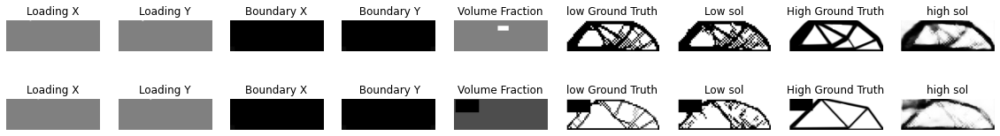

Time for epoch 62 is 37.77975916862488 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2098,0.0005331,0.2632]) 


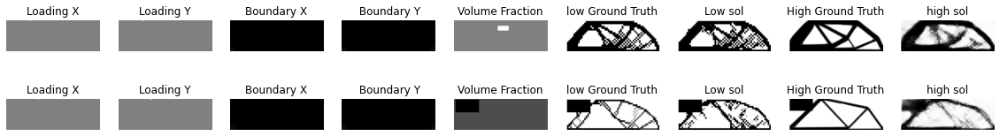

Time for epoch 63 is 37.865129709243774 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2077,0.0002884,0.2365]) 


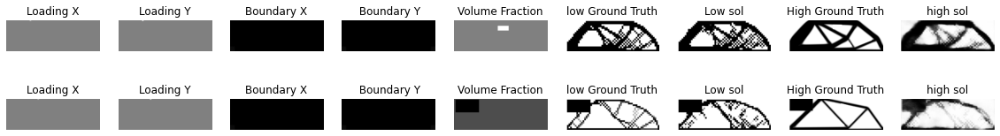

Time for epoch 64 is 37.91961121559143 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.217,0.0002183,0.2388]) 


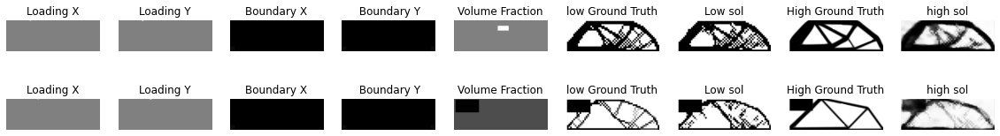

Time for epoch 65 is 37.84539580345154 sec: Training LOSS [highL1,comp_loss,total_loss]: [0.2034,0.0002256,0.226]) 


In [ ]:
high_loss_mat = htrain(low_dataset,high_dataset,100)

In [ ]:
# import torch as nn 
# ## COMPLIANCE - CNN PREDICT

In [ ]:
# class Graph: 
  
#     def __init__(self, row, col, g): 
#         self.ROW = row 
#         self.COL = col 
#         self.graph = g 
  
#     # A function to check if a given cell  
#     # (row, col) can be included in DFS 
#     def isSafe(self, i, j, visited): 
#         # row number is in range, column number 
#         # is in range and value is 1  
#         # and not yet visited 
#         return (i >= 0 and i < self.ROW and 
#                 j >= 0 and j < self.COL and 
#                 not visited[i][j] and self.graph[i][j]) 
              
  
#     # A utility function to do DFS for a 2D  
#     # boolean matrix. It only considers 
#     # the 8 neighbours as adjacent vertices 
#     def DFS(self, i, j, visited): 
  
#         # These arrays are used to get row and  
#         # column numbers of 8 neighbours  
#         # of a given cell 
#         rowNbr = [-1, -1, -1,  0, 0,  1, 1, 1]; 
#             colNbr = [-1,  0,  1, -1, 1, -1, 0, 1]; 
          
#         # Mark this cell as visited 
#         visited[i][j] = True
  
#         # Recur for all connected neighbours 
#         for k in range(8): 
#             if self.isSafe(i + rowNbr[k], j + colNbr[k], visited): 
#                 self.DFS(i + rowNbr[k], j + colNbr[k], visited) 
  
  
#     # The main function that returns 
#     # count of islands in a given boolean 
#     # 2D matrix 
#     def countIslands(self): 
#         # Make a bool array to mark visited cells. 
#         # Initially all cells are unvisited 
#         visited = [[False for j in range(self.COL)]for i in range(self.ROW)] 
  
#         # Initialize count as 0 and travese  
#         # through the all cells of 
#         # given matrix 
#         count = 0
#         for i in range(self.ROW): 
#             for j in range(self.COL): 
#                 # If a cell with value 1 is not visited yet,  
#                 # then new island found 
#                 if visited[i][j] == False and self.graph[i][j] == 1: 
#                     # Visit all cells in this island  
#                     # and increment island count 
#                     self.DFS(i, j, visited) 
#                     count += 1
  
#         return count 


In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))